# Afriat

In [1]:
import warnings
import os
import sys
import gc
import warnings

In [2]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
from tardis._utils.functions import create_random_mask
import sklearn
tardis.config = tardis.config_server

In [3]:
torch.cuda.is_available()

False

In [4]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [5]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [6]:
ratio_true=0.7

mask = create_random_mask(adata.shape[1], ratio_true=ratio_true, seed=2024)
adata.X[:, mask] = 0.0

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_ablation_{ratio_true}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: j7h8y4z0
Name: ancient-cruiser-147
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/j7h8y4z0
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155913-j7h8y4z0/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2552,3285,9406
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2552,2585,1675,3416,1645,3370
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4448,10795
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 653,824,2333
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 653,617,433,874,404,829
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1136,2674
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:13<2:12:31, 13.27s/it]

Epoch 1/600:   0%|          | 1/600 [00:13<2:12:31, 13.27s/it, v_num=z0_1, total_loss_train=1.44e+3, kl_local_train=53.5]

Epoch 2/600:   0%|          | 1/600 [00:13<2:12:31, 13.27s/it, v_num=z0_1, total_loss_train=1.44e+3, kl_local_train=53.5]

Epoch 2/600:   0%|          | 2/600 [00:25<2:05:44, 12.62s/it, v_num=z0_1, total_loss_train=1.44e+3, kl_local_train=53.5]

Epoch 2/600:   0%|          | 2/600 [00:25<2:05:44, 12.62s/it, v_num=z0_1, total_loss_train=1.03e+3, kl_local_train=85.4]

Epoch 3/600:   0%|          | 2/600 [00:25<2:05:44, 12.62s/it, v_num=z0_1, total_loss_train=1.03e+3, kl_local_train=85.4]

Epoch 3/600:   0%|          | 3/600 [00:37<2:01:44, 12.24s/it, v_num=z0_1, total_loss_train=1.03e+3, kl_local_train=85.4]

Epoch 3/600:   0%|          | 3/600 [00:37<2:01:44, 12.24s/it, v_num=z0_1, total_loss_train=994, kl_local_train=87.8]    

Epoch 4/600:   0%|          | 3/600 [00:37<2:01:44, 12.24s/it, v_num=z0_1, total_loss_train=994, kl_local_train=87.8]

Epoch 4/600:   1%|          | 4/600 [00:48<1:59:37, 12.04s/it, v_num=z0_1, total_loss_train=994, kl_local_train=87.8]

Epoch 4/600:   1%|          | 4/600 [00:48<1:59:37, 12.04s/it, v_num=z0_1, total_loss_train=983, kl_local_train=82.8]

Epoch 5/600:   1%|          | 4/600 [00:48<1:59:37, 12.04s/it, v_num=z0_1, total_loss_train=983, kl_local_train=82.8]

Epoch 5/600:   1%|          | 5/600 [01:01<1:59:54, 12.09s/it, v_num=z0_1, total_loss_train=983, kl_local_train=82.8]

Epoch 5/600:   1%|          | 5/600 [01:01<1:59:54, 12.09s/it, v_num=z0_1, total_loss_train=979, kl_local_train=73.1]

Epoch 6/600:   1%|          | 5/600 [01:02<1:59:54, 12.09s/it, v_num=z0_1, total_loss_train=979, kl_local_train=73.1]

Epoch 6/600:   1%|          | 6/600 [01:13<2:01:53, 12.31s/it, v_num=z0_1, total_loss_train=979, kl_local_train=73.1]

Epoch 6/600:   1%|          | 6/600 [01:13<2:01:53, 12.31s/it, v_num=z0_1, total_loss_train=976, kl_local_train=60, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 6/600 [01:13<2:01:53, 12.31s/it, v_num=z0_1, total_loss_train=976, kl_local_train=60, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 7/600 [01:25<1:59:35, 12.10s/it, v_num=z0_1, total_loss_train=976, kl_local_train=60, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 7/600 [01:25<1:59:35, 12.10s/it, v_num=z0_1, total_loss_train=975, kl_local_train=44.5, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|          | 7/600 [01:25<1:59:35, 12.10s/it, v_num=z0_1, total_loss_train=975, kl_local_train=44.5, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▏         | 8/600 [01:37<1:57:40, 11.93s/it, v_num=z0_1, total_loss_train=975, kl_local_train=44.5, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▏         | 8/600 [01:37<1:57:40, 11.93s/it, v_num=z0_1, total_loss_train=981, kl_local_train=26.8, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 9/600:   1%|▏         | 8/600 [01:37<1:57:40, 11.93s/it, v_num=z0_1, total_loss_train=981, kl_local_train=26.8, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▏         | 9/600 [01:48<1:56:17, 11.81s/it, v_num=z0_1, total_loss_train=981, kl_local_train=26.8, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▏         | 9/600 [01:48<1:56:17, 11.81s/it, v_num=z0_1, total_loss_train=988, kl_local_train=19.9, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 9/600 [01:48<1:56:17, 11.81s/it, v_num=z0_1, total_loss_train=988, kl_local_train=19.9, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 10/600 [02:00<1:55:31, 11.75s/it, v_num=z0_1, total_loss_train=988, kl_local_train=19.9, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 10/600 [02:00<1:55:31, 11.75s/it, v_num=z0_1, total_loss_train=995, kl_local_train=16.4, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 10/600 [02:01<1:55:31, 11.75s/it, v_num=z0_1, total_loss_train=995, kl_local_train=16.4, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 11/600 [02:13<1:58:28, 12.07s/it, v_num=z0_1, total_loss_train=995, kl_local_train=16.4, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00729, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 11/600 [02:13<1:58:28, 12.07s/it, v_num=z0_1, total_loss_train=1e+3, kl_local_train=29.7, metric_mi|status_control_train=0.0191, metric_mi|zone_train=0.0116, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 12/600:   2%|▏         | 11/600 [02:13<1:58:28, 12.07s/it, v_num=z0_1, total_loss_train=1e+3, kl_local_train=29.7, metric_mi|status_control_train=0.0191, metric_mi|zone_train=0.0116, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 12/600:   2%|▏         | 12/600 [02:24<1:56:47, 11.92s/it, v_num=z0_1, total_loss_train=1e+3, kl_local_train=29.7, metric_mi|status_control_train=0.0191, metric_mi|zone_train=0.0116, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 12/600:   2%|▏         | 12/600 [02:24<1:56:47, 11.92s/it, v_num=z0_1, total_loss_train=1e+3, kl_local_train=103, metric_mi|status_control_train=0.0191, metric_mi|zone_train=0.0116, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355] 

Epoch 13/600:   2%|▏         | 12/600 [02:24<1:56:47, 11.92s/it, v_num=z0_1, total_loss_train=1e+3, kl_local_train=103, metric_mi|status_control_train=0.0191, metric_mi|zone_train=0.0116, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 13/600:   2%|▏         | 13/600 [02:36<1:55:28, 11.80s/it, v_num=z0_1, total_loss_train=1e+3, kl_local_train=103, metric_mi|status_control_train=0.0191, metric_mi|zone_train=0.0116, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 13/600:   2%|▏         | 13/600 [02:36<1:55:28, 11.80s/it, v_num=z0_1, total_loss_train=1.01e+3, kl_local_train=138, metric_mi|status_control_train=0.0191, metric_mi|zone_train=0.0116, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 14/600:   2%|▏         | 13/600 [02:36<1:55:28, 11.80s/it, v_num=z0_1, total_loss_train=1.01e+3, kl_local_train=138, metric_mi|status_control_train=0.0191, metric_mi|zone_train=0.0116, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 14/600:   2%|▏         | 14/600 [02:47<1:54:28, 11.72s/it, v_num=z0_1, total_loss_train=1.01e+3, kl_local_train=138, metric_mi|status_control_train=0.0191, metric_mi|zone_train=0.0116, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 14/600:   2%|▏         | 14/600 [02:47<1:54:28, 11.72s/it, v_num=z0_1, total_loss_train=1.01e+3, kl_local_train=105, metric_mi|status_control_train=0.0191, metric_mi|zone_train=0.0116, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 15/600:   2%|▏         | 14/600 [02:47<1:54:28, 11.72s/it, v_num=z0_1, total_loss_train=1.01e+3, kl_local_train=105, metric_mi|status_control_train=0.0191, metric_mi|zone_train=0.0116, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 15/600:   2%|▎         | 15/600 [02:59<1:54:08, 11.71s/it, v_num=z0_1, total_loss_train=1.01e+3, kl_local_train=105, metric_mi|status_control_train=0.0191, metric_mi|zone_train=0.0116, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 15/600:   2%|▎         | 15/600 [02:59<1:54:08, 11.71s/it, v_num=z0_1, total_loss_train=1.01e+3, kl_local_train=89.4, metric_mi|status_control_train=0.0191, metric_mi|zone_train=0.0116, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 16/600:   2%|▎         | 15/600 [03:00<1:54:08, 11.71s/it, v_num=z0_1, total_loss_train=1.01e+3, kl_local_train=89.4, metric_mi|status_control_train=0.0191, metric_mi|zone_train=0.0116, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 16/600:   3%|▎         | 16/600 [03:12<1:57:11, 12.04s/it, v_num=z0_1, total_loss_train=1.01e+3, kl_local_train=89.4, metric_mi|status_control_train=0.0191, metric_mi|zone_train=0.0116, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0355]

Epoch 16/600:   3%|▎         | 16/600 [03:12<1:57:11, 12.04s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=129, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.0189, metric_mi|mouse_train=0.0433]  

Epoch 17/600:   3%|▎         | 16/600 [03:12<1:57:11, 12.04s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=129, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.0189, metric_mi|mouse_train=0.0433]

Epoch 17/600:   3%|▎         | 17/600 [03:23<1:55:41, 11.91s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=129, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.0189, metric_mi|mouse_train=0.0433]

Epoch 17/600:   3%|▎         | 17/600 [03:23<1:55:41, 11.91s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=154, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.0189, metric_mi|mouse_train=0.0433]

Epoch 18/600:   3%|▎         | 17/600 [03:23<1:55:41, 11.91s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=154, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.0189, metric_mi|mouse_train=0.0433]

Epoch 18/600:   3%|▎         | 18/600 [03:35<1:54:31, 11.81s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=154, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.0189, metric_mi|mouse_train=0.0433]

Epoch 18/600:   3%|▎         | 18/600 [03:35<1:54:31, 11.81s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=149, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.0189, metric_mi|mouse_train=0.0433]

Epoch 19/600:   3%|▎         | 18/600 [03:35<1:54:31, 11.81s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=149, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.0189, metric_mi|mouse_train=0.0433]

Epoch 19/600:   3%|▎         | 19/600 [03:46<1:53:39, 11.74s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=149, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.0189, metric_mi|mouse_train=0.0433]

Epoch 19/600:   3%|▎         | 19/600 [03:46<1:53:39, 11.74s/it, v_num=z0_1, total_loss_train=1.01e+3, kl_local_train=160, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.0189, metric_mi|mouse_train=0.0433]

Epoch 20/600:   3%|▎         | 19/600 [03:46<1:53:39, 11.74s/it, v_num=z0_1, total_loss_train=1.01e+3, kl_local_train=160, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.0189, metric_mi|mouse_train=0.0433]

Epoch 20/600:   3%|▎         | 20/600 [03:58<1:53:19, 11.72s/it, v_num=z0_1, total_loss_train=1.01e+3, kl_local_train=160, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.0189, metric_mi|mouse_train=0.0433]

Epoch 20/600:   3%|▎         | 20/600 [03:58<1:53:19, 11.72s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=166, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.0189, metric_mi|mouse_train=0.0433]

Epoch 21/600:   3%|▎         | 20/600 [03:59<1:53:19, 11.72s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=166, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.0189, metric_mi|mouse_train=0.0433]

Epoch 21/600:   4%|▎         | 21/600 [04:11<1:56:30, 12.07s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=166, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.0189, metric_mi|mouse_train=0.0433]

Epoch 21/600:   4%|▎         | 21/600 [04:11<1:56:30, 12.07s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=175, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.109]   

Epoch 22/600:   4%|▎         | 21/600 [04:11<1:56:30, 12.07s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=175, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.109]

Epoch 22/600:   4%|▎         | 22/600 [04:23<1:55:04, 11.95s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=175, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.109]

Epoch 22/600:   4%|▎         | 22/600 [04:23<1:55:04, 11.95s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=184, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.109]

Epoch 23/600:   4%|▎         | 22/600 [04:23<1:55:04, 11.95s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=184, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.109]

Epoch 23/600:   4%|▍         | 23/600 [04:34<1:53:54, 11.84s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=184, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.109]

Epoch 23/600:   4%|▍         | 23/600 [04:34<1:53:54, 11.84s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=192, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.109]

Epoch 24/600:   4%|▍         | 23/600 [04:34<1:53:54, 11.84s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=192, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.109]

Epoch 24/600:   4%|▍         | 24/600 [04:46<1:53:01, 11.77s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=192, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.109]

Epoch 24/600:   4%|▍         | 24/600 [04:46<1:53:01, 11.77s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=187, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.109]

Epoch 25/600:   4%|▍         | 24/600 [04:46<1:53:01, 11.77s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=187, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.109]

Epoch 25/600:   4%|▍         | 25/600 [04:58<1:52:27, 11.73s/it, v_num=z0_1, total_loss_train=1.02e+3, kl_local_train=187, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.109]

Epoch 25/600:   4%|▍         | 25/600 [04:58<1:52:27, 11.73s/it, v_num=z0_1, total_loss_train=1.03e+3, kl_local_train=182, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.109]

Epoch 26/600:   4%|▍         | 25/600 [04:59<1:52:27, 11.73s/it, v_num=z0_1, total_loss_train=1.03e+3, kl_local_train=182, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.109]

Epoch 26/600:   4%|▍         | 26/600 [05:10<1:55:32, 12.08s/it, v_num=z0_1, total_loss_train=1.03e+3, kl_local_train=182, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.109]

Epoch 26/600:   4%|▍         | 26/600 [05:10<1:55:32, 12.08s/it, v_num=z0_1, total_loss_train=1.03e+3, kl_local_train=181, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.133] 

Epoch 27/600:   4%|▍         | 26/600 [05:10<1:55:32, 12.08s/it, v_num=z0_1, total_loss_train=1.03e+3, kl_local_train=181, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.133]

Epoch 27/600:   4%|▍         | 27/600 [05:22<1:53:57, 11.93s/it, v_num=z0_1, total_loss_train=1.03e+3, kl_local_train=181, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.133]

Epoch 27/600:   4%|▍         | 27/600 [05:22<1:53:57, 11.93s/it, v_num=z0_1, total_loss_train=1.03e+3, kl_local_train=179, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.133]

Epoch 28/600:   4%|▍         | 27/600 [05:22<1:53:57, 11.93s/it, v_num=z0_1, total_loss_train=1.03e+3, kl_local_train=179, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.133]

Epoch 28/600:   5%|▍         | 28/600 [05:34<1:52:42, 11.82s/it, v_num=z0_1, total_loss_train=1.03e+3, kl_local_train=179, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.133]

Epoch 28/600:   5%|▍         | 28/600 [05:34<1:52:42, 11.82s/it, v_num=z0_1, total_loss_train=1.04e+3, kl_local_train=173, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.133]

Epoch 29/600:   5%|▍         | 28/600 [05:34<1:52:42, 11.82s/it, v_num=z0_1, total_loss_train=1.04e+3, kl_local_train=173, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.133]

Epoch 29/600:   5%|▍         | 29/600 [05:45<1:51:47, 11.75s/it, v_num=z0_1, total_loss_train=1.04e+3, kl_local_train=173, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.133]

Epoch 29/600:   5%|▍         | 29/600 [05:45<1:51:47, 11.75s/it, v_num=z0_1, total_loss_train=1.04e+3, kl_local_train=174, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.133]

Epoch 30/600:   5%|▍         | 29/600 [05:45<1:51:47, 11.75s/it, v_num=z0_1, total_loss_train=1.04e+3, kl_local_train=174, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.133]

Epoch 30/600:   5%|▌         | 30/600 [05:57<1:51:20, 11.72s/it, v_num=z0_1, total_loss_train=1.04e+3, kl_local_train=174, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.133]

Epoch 30/600:   5%|▌         | 30/600 [05:57<1:51:20, 11.72s/it, v_num=z0_1, total_loss_train=1.04e+3, kl_local_train=171, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.133]

Epoch 31/600:   5%|▌         | 30/600 [05:58<1:51:20, 11.72s/it, v_num=z0_1, total_loss_train=1.04e+3, kl_local_train=171, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.133]

Epoch 31/600:   5%|▌         | 31/600 [06:10<1:54:32, 12.08s/it, v_num=z0_1, total_loss_train=1.04e+3, kl_local_train=171, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.133]

Epoch 31/600:   5%|▌         | 31/600 [06:10<1:54:32, 12.08s/it, v_num=z0_1, total_loss_train=1.05e+3, kl_local_train=173, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.14] 

Epoch 32/600:   5%|▌         | 31/600 [06:10<1:54:32, 12.08s/it, v_num=z0_1, total_loss_train=1.05e+3, kl_local_train=173, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.14]

Epoch 32/600:   5%|▌         | 32/600 [06:21<1:53:04, 11.95s/it, v_num=z0_1, total_loss_train=1.05e+3, kl_local_train=173, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.14]

Epoch 32/600:   5%|▌         | 32/600 [06:21<1:53:04, 11.95s/it, v_num=z0_1, total_loss_train=1.05e+3, kl_local_train=171, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.14]

Epoch 33/600:   5%|▌         | 32/600 [06:21<1:53:04, 11.95s/it, v_num=z0_1, total_loss_train=1.05e+3, kl_local_train=171, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.14]

Epoch 33/600:   6%|▌         | 33/600 [06:33<1:51:56, 11.85s/it, v_num=z0_1, total_loss_train=1.05e+3, kl_local_train=171, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.14]

Epoch 33/600:   6%|▌         | 33/600 [06:33<1:51:56, 11.85s/it, v_num=z0_1, total_loss_train=1.05e+3, kl_local_train=170, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.14]

Epoch 34/600:   6%|▌         | 33/600 [06:33<1:51:56, 11.85s/it, v_num=z0_1, total_loss_train=1.05e+3, kl_local_train=170, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.14]

Epoch 34/600:   6%|▌         | 34/600 [06:45<1:51:06, 11.78s/it, v_num=z0_1, total_loss_train=1.05e+3, kl_local_train=170, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.14]

Epoch 34/600:   6%|▌         | 34/600 [06:45<1:51:06, 11.78s/it, v_num=z0_1, total_loss_train=1.06e+3, kl_local_train=166, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.14]

Epoch 35/600:   6%|▌         | 34/600 [06:45<1:51:06, 11.78s/it, v_num=z0_1, total_loss_train=1.06e+3, kl_local_train=166, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.14]

Epoch 35/600:   6%|▌         | 35/600 [06:56<1:50:34, 11.74s/it, v_num=z0_1, total_loss_train=1.06e+3, kl_local_train=166, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.14]

Epoch 35/600:   6%|▌         | 35/600 [06:56<1:50:34, 11.74s/it, v_num=z0_1, total_loss_train=1.06e+3, kl_local_train=164, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.14]

Epoch 36/600:   6%|▌         | 35/600 [06:57<1:50:34, 11.74s/it, v_num=z0_1, total_loss_train=1.06e+3, kl_local_train=164, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.14]

Epoch 36/600:   6%|▌         | 36/600 [07:09<1:53:34, 12.08s/it, v_num=z0_1, total_loss_train=1.06e+3, kl_local_train=164, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.14]

Epoch 36/600:   6%|▌         | 36/600 [07:09<1:53:34, 12.08s/it, v_num=z0_1, total_loss_train=1.06e+3, kl_local_train=163, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.145]

Epoch 37/600:   6%|▌         | 36/600 [07:09<1:53:34, 12.08s/it, v_num=z0_1, total_loss_train=1.06e+3, kl_local_train=163, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.145]

Epoch 37/600:   6%|▌         | 37/600 [07:21<1:52:05, 11.95s/it, v_num=z0_1, total_loss_train=1.06e+3, kl_local_train=163, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.145]

Epoch 37/600:   6%|▌         | 37/600 [07:21<1:52:05, 11.95s/it, v_num=z0_1, total_loss_train=1.07e+3, kl_local_train=165, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.145]

Epoch 38/600:   6%|▌         | 37/600 [07:21<1:52:05, 11.95s/it, v_num=z0_1, total_loss_train=1.07e+3, kl_local_train=165, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.145]

Epoch 38/600:   6%|▋         | 38/600 [07:32<1:50:59, 11.85s/it, v_num=z0_1, total_loss_train=1.07e+3, kl_local_train=165, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.145]

Epoch 38/600:   6%|▋         | 38/600 [07:32<1:50:59, 11.85s/it, v_num=z0_1, total_loss_train=1.07e+3, kl_local_train=160, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.145]

Epoch 39/600:   6%|▋         | 38/600 [07:32<1:50:59, 11.85s/it, v_num=z0_1, total_loss_train=1.07e+3, kl_local_train=160, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.145]

Epoch 39/600:   6%|▋         | 39/600 [07:44<1:50:11, 11.78s/it, v_num=z0_1, total_loss_train=1.07e+3, kl_local_train=160, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.145]

Epoch 39/600:   6%|▋         | 39/600 [07:44<1:50:11, 11.78s/it, v_num=z0_1, total_loss_train=1.07e+3, kl_local_train=161, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.145]

Epoch 40/600:   6%|▋         | 39/600 [07:44<1:50:11, 11.78s/it, v_num=z0_1, total_loss_train=1.07e+3, kl_local_train=161, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.145]

Epoch 40/600:   7%|▋         | 40/600 [07:56<1:49:45, 11.76s/it, v_num=z0_1, total_loss_train=1.07e+3, kl_local_train=161, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.145]

Epoch 40/600:   7%|▋         | 40/600 [07:56<1:49:45, 11.76s/it, v_num=z0_1, total_loss_train=1.08e+3, kl_local_train=162, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.145]

Epoch 41/600:   7%|▋         | 40/600 [07:57<1:49:45, 11.76s/it, v_num=z0_1, total_loss_train=1.08e+3, kl_local_train=162, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.145]

Epoch 41/600:   7%|▋         | 41/600 [08:09<1:52:42, 12.10s/it, v_num=z0_1, total_loss_train=1.08e+3, kl_local_train=162, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.145]

Epoch 41/600:   7%|▋         | 41/600 [08:09<1:52:42, 12.10s/it, v_num=z0_1, total_loss_train=1.08e+3, kl_local_train=163, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 42/600:   7%|▋         | 41/600 [08:09<1:52:42, 12.10s/it, v_num=z0_1, total_loss_train=1.08e+3, kl_local_train=163, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 42/600:   7%|▋         | 42/600 [08:20<1:51:13, 11.96s/it, v_num=z0_1, total_loss_train=1.08e+3, kl_local_train=163, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 42/600:   7%|▋         | 42/600 [08:20<1:51:13, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=162, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 43/600:   7%|▋         | 42/600 [08:20<1:51:13, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=162, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 43/600:   7%|▋         | 43/600 [08:32<1:50:02, 11.85s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=162, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 43/600:   7%|▋         | 43/600 [08:32<1:50:02, 11.85s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=163, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 44/600:   7%|▋         | 43/600 [08:32<1:50:02, 11.85s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=163, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 44/600:   7%|▋         | 44/600 [08:43<1:49:07, 11.78s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=163, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 44/600:   7%|▋         | 44/600 [08:43<1:49:07, 11.78s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=162, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 45/600:   7%|▋         | 44/600 [08:43<1:49:07, 11.78s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=162, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 45/600:   8%|▊         | 45/600 [08:55<1:48:42, 11.75s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=162, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 45/600:   8%|▊         | 45/600 [08:55<1:48:42, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=164, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145] 

Epoch 46/600:   8%|▊         | 45/600 [08:56<1:48:42, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=164, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 46/600:   8%|▊         | 46/600 [09:08<1:51:44, 12.10s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=164, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 46/600:   8%|▊         | 46/600 [09:08<1:51:44, 12.10s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=160, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.145]

Epoch 47/600:   8%|▊         | 46/600 [09:08<1:51:44, 12.10s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=160, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.145]

Epoch 47/600:   8%|▊         | 47/600 [09:20<1:50:23, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=160, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.145]

Epoch 47/600:   8%|▊         | 47/600 [09:20<1:50:23, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=160, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.145]

Epoch 48/600:   8%|▊         | 47/600 [09:20<1:50:23, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=160, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.145]

Epoch 48/600:   8%|▊         | 48/600 [09:31<1:49:15, 11.88s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=160, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.145]

Epoch 48/600:   8%|▊         | 48/600 [09:31<1:49:15, 11.88s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=159, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.145]

Epoch 49/600:   8%|▊         | 48/600 [09:31<1:49:15, 11.88s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=159, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.145]

Epoch 49/600:   8%|▊         | 49/600 [09:43<1:48:45, 11.84s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=159, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.145]

Epoch 49/600:   8%|▊         | 49/600 [09:43<1:48:45, 11.84s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=159, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.145]

Epoch 50/600:   8%|▊         | 49/600 [09:43<1:48:45, 11.84s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=159, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.145]

Epoch 50/600:   8%|▊         | 50/600 [09:55<1:48:17, 11.81s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=159, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.145]

Epoch 50/600:   8%|▊         | 50/600 [09:55<1:48:17, 11.81s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=162, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.145]

Epoch 51/600:   8%|▊         | 50/600 [09:56<1:48:17, 11.81s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=162, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.145]

Epoch 51/600:   8%|▊         | 51/600 [10:08<1:51:08, 12.15s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=162, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.145]

Epoch 51/600:   8%|▊         | 51/600 [10:08<1:51:08, 12.15s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=161, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146] 

Epoch 52/600:   8%|▊         | 51/600 [10:08<1:51:08, 12.15s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=161, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 52/600:   9%|▊         | 52/600 [10:19<1:49:40, 12.01s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=161, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 52/600:   9%|▊         | 52/600 [10:19<1:49:40, 12.01s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=158, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 53/600:   9%|▊         | 52/600 [10:19<1:49:40, 12.01s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=158, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 53/600:   9%|▉         | 53/600 [10:31<1:48:32, 11.91s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=158, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 53/600:   9%|▉         | 53/600 [10:31<1:48:32, 11.91s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=156, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 54/600:   9%|▉         | 53/600 [10:31<1:48:32, 11.91s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=156, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 54/600:   9%|▉         | 54/600 [10:43<1:47:41, 11.83s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=156, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 54/600:   9%|▉         | 54/600 [10:43<1:47:41, 11.83s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=155, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 55/600:   9%|▉         | 54/600 [10:43<1:47:41, 11.83s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=155, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 55/600:   9%|▉         | 55/600 [10:54<1:47:04, 11.79s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=155, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 55/600:   9%|▉         | 55/600 [10:54<1:47:04, 11.79s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=154, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 56/600:   9%|▉         | 55/600 [10:56<1:47:04, 11.79s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=154, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 56/600:   9%|▉         | 56/600 [11:07<1:49:57, 12.13s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=154, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.146]

Epoch 56/600:   9%|▉         | 56/600 [11:07<1:49:57, 12.13s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=155, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 57/600:   9%|▉         | 56/600 [11:07<1:49:57, 12.13s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=155, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 57/600:  10%|▉         | 57/600 [11:19<1:48:31, 11.99s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=155, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 57/600:  10%|▉         | 57/600 [11:19<1:48:31, 11.99s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=153, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 58/600:  10%|▉         | 57/600 [11:19<1:48:31, 11.99s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=153, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 58/600:  10%|▉         | 58/600 [11:31<1:47:24, 11.89s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=153, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 58/600:  10%|▉         | 58/600 [11:31<1:47:24, 11.89s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=149, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 59/600:  10%|▉         | 58/600 [11:31<1:47:24, 11.89s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=149, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 59/600:  10%|▉         | 59/600 [11:42<1:46:28, 11.81s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=149, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 59/600:  10%|▉         | 59/600 [11:42<1:46:28, 11.81s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=146, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 60/600:  10%|▉         | 59/600 [11:42<1:46:28, 11.81s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=146, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 60/600:  10%|█         | 60/600 [11:54<1:45:48, 11.76s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=146, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 60/600:  10%|█         | 60/600 [11:54<1:45:48, 11.76s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=145, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 61/600:  10%|█         | 60/600 [11:55<1:45:48, 11.76s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=145, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 61/600:  10%|█         | 61/600 [12:07<1:48:42, 12.10s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=145, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.145]

Epoch 61/600:  10%|█         | 61/600 [12:07<1:48:42, 12.10s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=143, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 62/600:  10%|█         | 61/600 [12:07<1:48:42, 12.10s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=143, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 62/600:  10%|█         | 62/600 [12:19<1:47:17, 11.97s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=143, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 62/600:  10%|█         | 62/600 [12:19<1:47:17, 11.97s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=141, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 63/600:  10%|█         | 62/600 [12:19<1:47:17, 11.97s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=141, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 63/600:  10%|█         | 63/600 [12:30<1:46:14, 11.87s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=141, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 63/600:  10%|█         | 63/600 [12:30<1:46:14, 11.87s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=142, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 64/600:  10%|█         | 63/600 [12:30<1:46:14, 11.87s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=142, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 64/600:  11%|█         | 64/600 [12:42<1:45:23, 11.80s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=142, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 64/600:  11%|█         | 64/600 [12:42<1:45:23, 11.80s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=144, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 65/600:  11%|█         | 64/600 [12:42<1:45:23, 11.80s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=144, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 65/600:  11%|█         | 65/600 [12:54<1:45:01, 11.78s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=144, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 65/600:  11%|█         | 65/600 [12:54<1:45:01, 11.78s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=144, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 66/600:  11%|█         | 65/600 [12:55<1:45:01, 11.78s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=144, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 66/600:  11%|█         | 66/600 [13:06<1:47:48, 12.11s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=144, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 66/600:  11%|█         | 66/600 [13:06<1:47:48, 12.11s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=143, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.148]

Epoch 67/600:  11%|█         | 66/600 [13:06<1:47:48, 12.11s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=143, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.148]

Epoch 67/600:  11%|█         | 67/600 [13:18<1:46:28, 11.99s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=143, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.148]

Epoch 67/600:  11%|█         | 67/600 [13:18<1:46:28, 11.99s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=141, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.148]

Epoch 68/600:  11%|█         | 67/600 [13:18<1:46:28, 11.99s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=141, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.148]

Epoch 68/600:  11%|█▏        | 68/600 [13:30<1:45:23, 11.89s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=141, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.148]

Epoch 68/600:  11%|█▏        | 68/600 [13:30<1:45:23, 11.89s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=141, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.148]

Epoch 69/600:  11%|█▏        | 68/600 [13:30<1:45:23, 11.89s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=141, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.148]

Epoch 69/600:  12%|█▏        | 69/600 [13:41<1:44:32, 11.81s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=141, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.148]

Epoch 69/600:  12%|█▏        | 69/600 [13:41<1:44:32, 11.81s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=141, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.148]

Epoch 70/600:  12%|█▏        | 69/600 [13:41<1:44:32, 11.81s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=141, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.148]

Epoch 70/600:  12%|█▏        | 70/600 [13:53<1:43:57, 11.77s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=141, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.148]

Epoch 70/600:  12%|█▏        | 70/600 [13:53<1:43:57, 11.77s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=140, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.148]

Epoch 71/600:  12%|█▏        | 70/600 [13:54<1:43:57, 11.77s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=140, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.148]

Epoch 71/600:  12%|█▏        | 71/600 [14:06<1:46:48, 12.11s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=140, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.148]

Epoch 71/600:  12%|█▏        | 71/600 [14:06<1:46:48, 12.11s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=140, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.149] 

Epoch 72/600:  12%|█▏        | 71/600 [14:06<1:46:48, 12.11s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=140, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.149]

Epoch 72/600:  12%|█▏        | 72/600 [14:18<1:45:27, 11.98s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=140, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.149]

Epoch 72/600:  12%|█▏        | 72/600 [14:18<1:45:27, 11.98s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=140, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.149]

Epoch 73/600:  12%|█▏        | 72/600 [14:18<1:45:27, 11.98s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=140, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.149]

Epoch 73/600:  12%|█▏        | 73/600 [14:29<1:44:24, 11.89s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=140, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.149]

Epoch 73/600:  12%|█▏        | 73/600 [14:29<1:44:24, 11.89s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=140, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.149]

Epoch 74/600:  12%|█▏        | 73/600 [14:29<1:44:24, 11.89s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=140, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.149]

Epoch 74/600:  12%|█▏        | 74/600 [14:41<1:43:36, 11.82s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=140, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.149]

Epoch 74/600:  12%|█▏        | 74/600 [14:41<1:43:36, 11.82s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=137, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.149]

Epoch 75/600:  12%|█▏        | 74/600 [14:41<1:43:36, 11.82s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=137, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.149]

Epoch 75/600:  12%|█▎        | 75/600 [14:53<1:43:28, 11.83s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=137, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.149]

Epoch 75/600:  12%|█▎        | 75/600 [14:53<1:43:28, 11.83s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=136, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.149]

Epoch 76/600:  12%|█▎        | 75/600 [14:54<1:43:28, 11.83s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=136, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.149]

Epoch 76/600:  13%|█▎        | 76/600 [15:06<1:46:12, 12.16s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=136, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.149]

Epoch 76/600:  13%|█▎        | 76/600 [15:06<1:46:12, 12.16s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=137, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.154]

Epoch 77/600:  13%|█▎        | 76/600 [15:06<1:46:12, 12.16s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=137, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.154]

Epoch 77/600:  13%|█▎        | 77/600 [15:18<1:44:46, 12.02s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=137, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.154]

Epoch 77/600:  13%|█▎        | 77/600 [15:18<1:44:46, 12.02s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=137, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.154]

Epoch 78/600:  13%|█▎        | 77/600 [15:18<1:44:46, 12.02s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=137, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.154]

Epoch 78/600:  13%|█▎        | 78/600 [15:29<1:43:31, 11.90s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=137, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.154]

Epoch 78/600:  13%|█▎        | 78/600 [15:29<1:43:31, 11.90s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=136, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.154]

Epoch 79/600:  13%|█▎        | 78/600 [15:29<1:43:31, 11.90s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=136, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.154]

Epoch 79/600:  13%|█▎        | 79/600 [15:41<1:42:39, 11.82s/it, v_num=z0_1, total_loss_train=1.11e+3, kl_local_train=136, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.154]

Epoch 79/600:  13%|█▎        | 79/600 [15:41<1:42:39, 11.82s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=135, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.154] 

Epoch 80/600:  13%|█▎        | 79/600 [15:41<1:42:39, 11.82s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=135, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.154]

Epoch 80/600:  13%|█▎        | 80/600 [15:52<1:41:55, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=135, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.154]

Epoch 80/600:  13%|█▎        | 80/600 [15:52<1:41:55, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=134, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.154]

Epoch 81/600:  13%|█▎        | 80/600 [15:54<1:41:55, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=134, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.154]

Epoch 81/600:  14%|█▎        | 81/600 [16:05<1:44:35, 12.09s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=134, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.201, metric_mi|mouse_train=0.154]

Epoch 81/600:  14%|█▎        | 81/600 [16:05<1:44:35, 12.09s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=133, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148] 

Epoch 82/600:  14%|█▎        | 81/600 [16:05<1:44:35, 12.09s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=133, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 82/600:  14%|█▎        | 82/600 [16:17<1:43:11, 11.95s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=133, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 82/600:  14%|█▎        | 82/600 [16:17<1:43:11, 11.95s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=133, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 83/600:  14%|█▎        | 82/600 [16:17<1:43:11, 11.95s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=133, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 83/600:  14%|█▍        | 83/600 [16:28<1:42:07, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=133, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 83/600:  14%|█▍        | 83/600 [16:28<1:42:07, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=132, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 84/600:  14%|█▍        | 83/600 [16:29<1:42:07, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=132, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 84/600:  14%|█▍        | 84/600 [16:40<1:41:19, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=132, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 84/600:  14%|█▍        | 84/600 [16:40<1:41:19, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=130, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 85/600:  14%|█▍        | 84/600 [16:40<1:41:19, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=130, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 85/600:  14%|█▍        | 85/600 [16:52<1:40:40, 11.73s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=130, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 85/600:  14%|█▍        | 85/600 [16:52<1:40:40, 11.73s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=129, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 86/600:  14%|█▍        | 85/600 [16:53<1:40:40, 11.73s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=129, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 86/600:  14%|█▍        | 86/600 [17:05<1:43:28, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=129, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 86/600:  14%|█▍        | 86/600 [17:05<1:43:28, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=129, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.146]

Epoch 87/600:  14%|█▍        | 86/600 [17:05<1:43:28, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=129, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.146]

Epoch 87/600:  14%|█▍        | 87/600 [17:16<1:42:10, 11.95s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=129, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.146]

Epoch 87/600:  14%|█▍        | 87/600 [17:16<1:42:10, 11.95s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=130, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.146]

Epoch 88/600:  14%|█▍        | 87/600 [17:16<1:42:10, 11.95s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=130, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.146]

Epoch 88/600:  15%|█▍        | 88/600 [17:28<1:41:12, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=130, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.146]

Epoch 88/600:  15%|█▍        | 88/600 [17:28<1:41:12, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=128, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.146]

Epoch 89/600:  15%|█▍        | 88/600 [17:28<1:41:12, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=128, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.146]

Epoch 89/600:  15%|█▍        | 89/600 [17:40<1:40:27, 11.80s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=128, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.146]

Epoch 89/600:  15%|█▍        | 89/600 [17:40<1:40:27, 11.80s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=128, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.146]

Epoch 90/600:  15%|█▍        | 89/600 [17:40<1:40:27, 11.80s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=128, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.146]

Epoch 90/600:  15%|█▌        | 90/600 [17:51<1:39:51, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=128, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.146]

Epoch 90/600:  15%|█▌        | 90/600 [17:51<1:39:51, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=127, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.146]

Epoch 91/600:  15%|█▌        | 90/600 [17:52<1:39:51, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=127, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.146]

Epoch 91/600:  15%|█▌        | 91/600 [18:04<1:42:37, 12.10s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=127, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.146]

Epoch 91/600:  15%|█▌        | 91/600 [18:04<1:42:37, 12.10s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=126, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14] 

Epoch 92/600:  15%|█▌        | 91/600 [18:04<1:42:37, 12.10s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=126, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 92/600:  15%|█▌        | 92/600 [18:16<1:41:18, 11.97s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=126, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 92/600:  15%|█▌        | 92/600 [18:16<1:41:18, 11.97s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=127, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 93/600:  15%|█▌        | 92/600 [18:16<1:41:18, 11.97s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=127, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 93/600:  16%|█▌        | 93/600 [18:27<1:40:17, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=127, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 93/600:  16%|█▌        | 93/600 [18:27<1:40:17, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=126, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 94/600:  16%|█▌        | 93/600 [18:27<1:40:17, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=126, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 94/600:  16%|█▌        | 94/600 [18:39<1:39:33, 11.81s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=126, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 94/600:  16%|█▌        | 94/600 [18:39<1:39:33, 11.81s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=125, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 95/600:  16%|█▌        | 94/600 [18:39<1:39:33, 11.81s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=125, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 95/600:  16%|█▌        | 95/600 [18:51<1:39:05, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=125, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 95/600:  16%|█▌        | 95/600 [18:51<1:39:05, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=123, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 96/600:  16%|█▌        | 95/600 [18:52<1:39:05, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=123, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 96/600:  16%|█▌        | 96/600 [19:04<1:41:39, 12.10s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=123, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 96/600:  16%|█▌        | 96/600 [19:04<1:41:39, 12.10s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.143]

Epoch 97/600:  16%|█▌        | 96/600 [19:04<1:41:39, 12.10s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.143]

Epoch 97/600:  16%|█▌        | 97/600 [19:15<1:40:21, 11.97s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.143]

Epoch 97/600:  16%|█▌        | 97/600 [19:15<1:40:21, 11.97s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.143]

Epoch 98/600:  16%|█▌        | 97/600 [19:15<1:40:21, 11.97s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.143]

Epoch 98/600:  16%|█▋        | 98/600 [19:27<1:39:21, 11.88s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.143]

Epoch 98/600:  16%|█▋        | 98/600 [19:27<1:39:21, 11.88s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.143]

Epoch 99/600:  16%|█▋        | 98/600 [19:27<1:39:21, 11.88s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.143]

Epoch 99/600:  16%|█▋        | 99/600 [19:39<1:38:33, 11.80s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.143]

Epoch 99/600:  16%|█▋        | 99/600 [19:39<1:38:33, 11.80s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=122, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.143]

Epoch 100/600:  16%|█▋        | 99/600 [19:39<1:38:33, 11.80s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=122, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.143]

Epoch 100/600:  17%|█▋        | 100/600 [19:50<1:38:24, 11.81s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=122, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.143]

Epoch 100/600:  17%|█▋        | 100/600 [19:50<1:38:24, 11.81s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.143]

Epoch 101/600:  17%|█▋        | 100/600 [19:52<1:38:24, 11.81s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.143]

Epoch 101/600:  17%|█▋        | 101/600 [20:03<1:41:18, 12.18s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.143]

Epoch 101/600:  17%|█▋        | 101/600 [20:03<1:41:18, 12.18s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=120, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.144]

Epoch 102/600:  17%|█▋        | 101/600 [20:03<1:41:18, 12.18s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=120, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.144]

Epoch 102/600:  17%|█▋        | 102/600 [20:15<1:40:14, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=120, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.144]

Epoch 102/600:  17%|█▋        | 102/600 [20:15<1:40:14, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=122, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.144]

Epoch 103/600:  17%|█▋        | 102/600 [20:15<1:40:14, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=122, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.144]

Epoch 103/600:  17%|█▋        | 103/600 [20:27<1:39:16, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=122, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.144]

Epoch 103/600:  17%|█▋        | 103/600 [20:27<1:39:16, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=120, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.144]

Epoch 104/600:  17%|█▋        | 103/600 [20:27<1:39:16, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=120, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.144]

Epoch 104/600:  17%|█▋        | 104/600 [20:39<1:38:34, 11.92s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=120, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.144]

Epoch 104/600:  17%|█▋        | 104/600 [20:39<1:38:34, 11.92s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=120, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.144]

Epoch 105/600:  17%|█▋        | 104/600 [20:39<1:38:34, 11.92s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=120, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.144]

Epoch 105/600:  18%|█▊        | 105/600 [20:51<1:38:04, 11.89s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=120, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.144]

Epoch 105/600:  18%|█▊        | 105/600 [20:51<1:38:04, 11.89s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=119, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.144]

Epoch 106/600:  18%|█▊        | 105/600 [20:52<1:38:04, 11.89s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=119, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.144]

Epoch 106/600:  18%|█▊        | 106/600 [21:04<1:40:42, 12.23s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=119, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.144]

Epoch 106/600:  18%|█▊        | 106/600 [21:04<1:40:42, 12.23s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=118, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148] 

Epoch 107/600:  18%|█▊        | 106/600 [21:04<1:40:42, 12.23s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=118, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 107/600:  18%|█▊        | 107/600 [21:15<1:39:21, 12.09s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=118, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 107/600:  18%|█▊        | 107/600 [21:15<1:39:21, 12.09s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=117, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 108/600:  18%|█▊        | 107/600 [21:15<1:39:21, 12.09s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=117, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 108/600:  18%|█▊        | 108/600 [21:27<1:38:21, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=117, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 108/600:  18%|█▊        | 108/600 [21:27<1:38:21, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=119, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 109/600:  18%|█▊        | 108/600 [21:27<1:38:21, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=119, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 109/600:  18%|█▊        | 109/600 [21:39<1:37:39, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=119, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 109/600:  18%|█▊        | 109/600 [21:39<1:37:39, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=117, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 110/600:  18%|█▊        | 109/600 [21:39<1:37:39, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=117, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 110/600:  18%|█▊        | 110/600 [21:51<1:37:04, 11.89s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=117, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 110/600:  18%|█▊        | 110/600 [21:51<1:37:04, 11.89s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=116, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 111/600:  18%|█▊        | 110/600 [21:52<1:37:04, 11.89s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=116, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 111/600:  18%|█▊        | 111/600 [22:04<1:39:43, 12.24s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=116, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 111/600:  18%|█▊        | 111/600 [22:04<1:39:43, 12.24s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=116, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148] 

Epoch 112/600:  18%|█▊        | 111/600 [22:04<1:39:43, 12.24s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=116, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 112/600:  19%|█▊        | 112/600 [22:16<1:38:26, 12.10s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=116, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 112/600:  19%|█▊        | 112/600 [22:16<1:38:26, 12.10s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=115, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 113/600:  19%|█▊        | 112/600 [22:16<1:38:26, 12.10s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=115, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 113/600:  19%|█▉        | 113/600 [22:27<1:37:25, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=115, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 113/600:  19%|█▉        | 113/600 [22:27<1:37:25, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=115, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 114/600:  19%|█▉        | 113/600 [22:27<1:37:25, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=115, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 114/600:  19%|█▉        | 114/600 [22:39<1:36:38, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=115, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 114/600:  19%|█▉        | 114/600 [22:39<1:36:38, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=116, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 115/600:  19%|█▉        | 114/600 [22:39<1:36:38, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=116, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 115/600:  19%|█▉        | 115/600 [22:51<1:35:57, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=116, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 115/600:  19%|█▉        | 115/600 [22:51<1:35:57, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=116, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 116/600:  19%|█▉        | 115/600 [22:52<1:35:57, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=116, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 116/600:  19%|█▉        | 116/600 [23:04<1:38:29, 12.21s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=116, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.148]

Epoch 116/600:  19%|█▉        | 116/600 [23:04<1:38:29, 12.21s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=116, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.147]

Epoch 117/600:  19%|█▉        | 116/600 [23:04<1:38:29, 12.21s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=116, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.147]

Epoch 117/600:  20%|█▉        | 117/600 [23:16<1:37:13, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=116, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.147]

Epoch 117/600:  20%|█▉        | 117/600 [23:16<1:37:13, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=114, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.147]

Epoch 118/600:  20%|█▉        | 117/600 [23:16<1:37:13, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=114, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.147]

Epoch 118/600:  20%|█▉        | 118/600 [23:27<1:36:13, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=114, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.147]

Epoch 118/600:  20%|█▉        | 118/600 [23:27<1:36:13, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=114, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.147]

Epoch 119/600:  20%|█▉        | 118/600 [23:27<1:36:13, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=114, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.147]

Epoch 119/600:  20%|█▉        | 119/600 [23:39<1:35:29, 11.91s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=114, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.147]

Epoch 119/600:  20%|█▉        | 119/600 [23:39<1:35:29, 11.91s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=115, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.147]

Epoch 120/600:  20%|█▉        | 119/600 [23:39<1:35:29, 11.91s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=115, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.147]

Epoch 120/600:  20%|██        | 120/600 [23:51<1:34:59, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=115, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.147]

Epoch 120/600:  20%|██        | 120/600 [23:51<1:34:59, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=113, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.147]

Epoch 121/600:  20%|██        | 120/600 [23:52<1:34:59, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=113, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.147]

Epoch 121/600:  20%|██        | 121/600 [24:04<1:37:33, 12.22s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=113, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.147]

Epoch 121/600:  20%|██        | 121/600 [24:04<1:37:33, 12.22s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=113, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 122/600:  20%|██        | 121/600 [24:04<1:37:33, 12.22s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=113, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 122/600:  20%|██        | 122/600 [24:16<1:36:16, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=113, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 122/600:  20%|██        | 122/600 [24:16<1:36:16, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=112, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 123/600:  20%|██        | 122/600 [24:16<1:36:16, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=112, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 123/600:  20%|██        | 123/600 [24:28<1:35:20, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=112, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 123/600:  20%|██        | 123/600 [24:28<1:35:20, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=111, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 124/600:  20%|██        | 123/600 [24:28<1:35:20, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=111, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 124/600:  21%|██        | 124/600 [24:39<1:34:37, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=111, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 124/600:  21%|██        | 124/600 [24:39<1:34:37, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=111, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 125/600:  21%|██        | 124/600 [24:39<1:34:37, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=111, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 125/600:  21%|██        | 125/600 [24:51<1:34:29, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=111, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 125/600:  21%|██        | 125/600 [24:51<1:34:29, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=110, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 126/600:  21%|██        | 125/600 [24:53<1:34:29, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=110, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 126/600:  21%|██        | 126/600 [25:04<1:36:58, 12.27s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=110, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.147]

Epoch 126/600:  21%|██        | 126/600 [25:04<1:36:58, 12.27s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=111, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 127/600:  21%|██        | 126/600 [25:04<1:36:58, 12.27s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=111, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 127/600:  21%|██        | 127/600 [25:16<1:35:37, 12.13s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=111, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 127/600:  21%|██        | 127/600 [25:16<1:35:37, 12.13s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=111, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 128/600:  21%|██        | 127/600 [25:16<1:35:37, 12.13s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=111, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 128/600:  21%|██▏       | 128/600 [25:28<1:34:38, 12.03s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=111, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 128/600:  21%|██▏       | 128/600 [25:28<1:34:38, 12.03s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=110, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 129/600:  21%|██▏       | 128/600 [25:28<1:34:38, 12.03s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=110, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 129/600:  22%|██▏       | 129/600 [25:40<1:33:55, 11.96s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=110, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 129/600:  22%|██▏       | 129/600 [25:40<1:33:55, 11.96s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=110, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 130/600:  22%|██▏       | 129/600 [25:40<1:33:55, 11.96s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=110, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 130/600:  22%|██▏       | 130/600 [25:51<1:33:16, 11.91s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=110, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 130/600:  22%|██▏       | 130/600 [25:51<1:33:16, 11.91s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=109, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 131/600:  22%|██▏       | 130/600 [25:53<1:33:16, 11.91s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=109, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 131/600:  22%|██▏       | 131/600 [26:05<1:35:44, 12.25s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=109, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 131/600:  22%|██▏       | 131/600 [26:05<1:35:44, 12.25s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=108, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 132/600:  22%|██▏       | 131/600 [26:05<1:35:44, 12.25s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=108, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 132/600:  22%|██▏       | 132/600 [26:16<1:34:27, 12.11s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=108, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 132/600:  22%|██▏       | 132/600 [26:16<1:34:27, 12.11s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=108, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 133/600:  22%|██▏       | 132/600 [26:16<1:34:27, 12.11s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=108, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 133/600:  22%|██▏       | 133/600 [26:28<1:33:27, 12.01s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=108, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 133/600:  22%|██▏       | 133/600 [26:28<1:33:27, 12.01s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=108, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 134/600:  22%|██▏       | 133/600 [26:28<1:33:27, 12.01s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=108, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 134/600:  22%|██▏       | 134/600 [26:40<1:32:42, 11.94s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=108, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 134/600:  22%|██▏       | 134/600 [26:40<1:32:42, 11.94s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=109, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 135/600:  22%|██▏       | 134/600 [26:40<1:32:42, 11.94s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=109, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 135/600:  22%|██▎       | 135/600 [26:52<1:32:02, 11.88s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=109, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 135/600:  22%|██▎       | 135/600 [26:52<1:32:02, 11.88s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=108, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 136/600:  22%|██▎       | 135/600 [26:53<1:32:02, 11.88s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=108, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 136/600:  23%|██▎       | 136/600 [27:05<1:34:33, 12.23s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=108, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 136/600:  23%|██▎       | 136/600 [27:05<1:34:33, 12.23s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=107, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14] 

Epoch 137/600:  23%|██▎       | 136/600 [27:05<1:34:33, 12.23s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=107, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 137/600:  23%|██▎       | 137/600 [27:16<1:33:20, 12.10s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=107, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 137/600:  23%|██▎       | 137/600 [27:16<1:33:20, 12.10s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=107, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 138/600:  23%|██▎       | 137/600 [27:16<1:33:20, 12.10s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=107, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 138/600:  23%|██▎       | 138/600 [27:28<1:32:22, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=107, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 138/600:  23%|██▎       | 138/600 [27:28<1:32:22, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=106, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 139/600:  23%|██▎       | 138/600 [27:28<1:32:22, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=106, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 139/600:  23%|██▎       | 139/600 [27:40<1:31:40, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=106, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 139/600:  23%|██▎       | 139/600 [27:40<1:31:40, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=105, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 140/600:  23%|██▎       | 139/600 [27:40<1:31:40, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=105, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 140/600:  23%|██▎       | 140/600 [27:52<1:31:01, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=105, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 140/600:  23%|██▎       | 140/600 [27:52<1:31:01, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=105, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 141/600:  23%|██▎       | 140/600 [27:53<1:31:01, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=105, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 141/600:  24%|██▎       | 141/600 [28:05<1:33:29, 12.22s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=105, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 141/600:  24%|██▎       | 141/600 [28:05<1:33:29, 12.22s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=105, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 142/600:  24%|██▎       | 141/600 [28:05<1:33:29, 12.22s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=105, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 142/600:  24%|██▎       | 142/600 [28:17<1:32:20, 12.10s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=105, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 142/600:  24%|██▎       | 142/600 [28:17<1:32:20, 12.10s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=105, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 143/600:  24%|██▎       | 142/600 [28:17<1:32:20, 12.10s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=105, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 143/600:  24%|██▍       | 143/600 [28:28<1:31:24, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=105, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 143/600:  24%|██▍       | 143/600 [28:28<1:31:24, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=103, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 144/600:  24%|██▍       | 143/600 [28:28<1:31:24, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=103, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 144/600:  24%|██▍       | 144/600 [28:40<1:30:42, 11.94s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=103, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 144/600:  24%|██▍       | 144/600 [28:40<1:30:42, 11.94s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=104, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 145/600:  24%|██▍       | 144/600 [28:40<1:30:42, 11.94s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=104, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 145/600:  24%|██▍       | 145/600 [28:52<1:30:11, 11.89s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=104, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 145/600:  24%|██▍       | 145/600 [28:52<1:30:11, 11.89s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=105, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 146/600:  24%|██▍       | 145/600 [28:53<1:30:11, 11.89s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=105, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 146/600:  24%|██▍       | 146/600 [29:05<1:32:40, 12.25s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=105, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.137]

Epoch 146/600:  24%|██▍       | 146/600 [29:05<1:32:40, 12.25s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=103, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 147/600:  24%|██▍       | 146/600 [29:05<1:32:40, 12.25s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=103, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 147/600:  24%|██▍       | 147/600 [29:17<1:31:30, 12.12s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=103, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 147/600:  24%|██▍       | 147/600 [29:17<1:31:30, 12.12s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=103, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 148/600:  24%|██▍       | 147/600 [29:17<1:31:30, 12.12s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=103, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 148/600:  25%|██▍       | 148/600 [29:29<1:30:35, 12.02s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=103, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 148/600:  25%|██▍       | 148/600 [29:29<1:30:35, 12.02s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=103, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 149/600:  25%|██▍       | 148/600 [29:29<1:30:35, 12.02s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=103, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 149/600:  25%|██▍       | 149/600 [29:40<1:29:55, 11.96s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=103, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 149/600:  25%|██▍       | 149/600 [29:40<1:29:55, 11.96s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=102, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 150/600:  25%|██▍       | 149/600 [29:40<1:29:55, 11.96s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=102, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 150/600:  25%|██▌       | 150/600 [29:53<1:30:07, 12.02s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=102, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 150/600:  25%|██▌       | 150/600 [29:53<1:30:07, 12.02s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=102, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 151/600:  25%|██▌       | 150/600 [29:54<1:30:07, 12.02s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=102, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 151/600:  25%|██▌       | 151/600 [30:06<1:32:19, 12.34s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=102, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 151/600:  25%|██▌       | 151/600 [30:06<1:32:19, 12.34s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=102, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 152/600:  25%|██▌       | 151/600 [30:06<1:32:19, 12.34s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=102, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 152/600:  25%|██▌       | 152/600 [30:17<1:30:52, 12.17s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=102, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 152/600:  25%|██▌       | 152/600 [30:17<1:30:52, 12.17s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=102, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 153/600:  25%|██▌       | 152/600 [30:17<1:30:52, 12.17s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=102, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 153/600:  26%|██▌       | 153/600 [30:29<1:29:45, 12.05s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=102, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 153/600:  26%|██▌       | 153/600 [30:29<1:29:45, 12.05s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=101, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 154/600:  26%|██▌       | 153/600 [30:29<1:29:45, 12.05s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=101, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 154/600:  26%|██▌       | 154/600 [30:41<1:28:56, 11.96s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=101, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 154/600:  26%|██▌       | 154/600 [30:41<1:28:56, 11.96s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=100, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 155/600:  26%|██▌       | 154/600 [30:41<1:28:56, 11.96s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=100, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 155/600:  26%|██▌       | 155/600 [30:53<1:28:21, 11.91s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=100, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 155/600:  26%|██▌       | 155/600 [30:53<1:28:21, 11.91s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=100, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 156/600:  26%|██▌       | 155/600 [30:54<1:28:21, 11.91s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=100, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 156/600:  26%|██▌       | 156/600 [31:06<1:30:34, 12.24s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=100, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.142]

Epoch 156/600:  26%|██▌       | 156/600 [31:06<1:30:34, 12.24s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=100, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14] 

Epoch 157/600:  26%|██▌       | 156/600 [31:06<1:30:34, 12.24s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=100, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 157/600:  26%|██▌       | 157/600 [31:18<1:29:16, 12.09s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=100, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 157/600:  26%|██▌       | 157/600 [31:18<1:29:16, 12.09s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=99.8, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 158/600:  26%|██▌       | 157/600 [31:18<1:29:16, 12.09s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=99.8, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 158/600:  26%|██▋       | 158/600 [31:29<1:28:18, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=99.8, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 158/600:  26%|██▋       | 158/600 [31:29<1:28:18, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=99.8, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 159/600:  26%|██▋       | 158/600 [31:29<1:28:18, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=99.8, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 159/600:  26%|██▋       | 159/600 [31:41<1:27:35, 11.92s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=99.8, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 159/600:  26%|██▋       | 159/600 [31:41<1:27:35, 11.92s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=100, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14] 

Epoch 160/600:  26%|██▋       | 159/600 [31:41<1:27:35, 11.92s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=100, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 160/600:  27%|██▋       | 160/600 [31:53<1:27:03, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=100, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 160/600:  27%|██▋       | 160/600 [31:53<1:27:03, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=99.6, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 161/600:  27%|██▋       | 160/600 [31:54<1:27:03, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=99.6, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 161/600:  27%|██▋       | 161/600 [32:06<1:29:21, 12.21s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=99.6, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 161/600:  27%|██▋       | 161/600 [32:06<1:29:21, 12.21s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=98.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 162/600:  27%|██▋       | 161/600 [32:06<1:29:21, 12.21s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=98.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 162/600:  27%|██▋       | 162/600 [32:18<1:28:11, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=98.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 162/600:  27%|██▋       | 162/600 [32:18<1:28:11, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=98.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 163/600:  27%|██▋       | 162/600 [32:18<1:28:11, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=98.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 163/600:  27%|██▋       | 163/600 [32:29<1:27:14, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=98.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 163/600:  27%|██▋       | 163/600 [32:29<1:27:14, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=98.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 164/600:  27%|██▋       | 163/600 [32:29<1:27:14, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=98.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 164/600:  27%|██▋       | 164/600 [32:41<1:26:33, 11.91s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=98.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 164/600:  27%|██▋       | 164/600 [32:41<1:26:33, 11.91s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=97.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 165/600:  27%|██▋       | 164/600 [32:41<1:26:33, 11.91s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=97.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 165/600:  28%|██▊       | 165/600 [32:53<1:26:09, 11.88s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=97.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 165/600:  28%|██▊       | 165/600 [32:53<1:26:09, 11.88s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=97.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 166/600:  28%|██▊       | 165/600 [32:54<1:26:09, 11.88s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=97.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 166/600:  28%|██▊       | 166/600 [33:06<1:28:23, 12.22s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=97.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 166/600:  28%|██▊       | 166/600 [33:06<1:28:23, 12.22s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=97.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 167/600:  28%|██▊       | 166/600 [33:06<1:28:23, 12.22s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=97.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 167/600:  28%|██▊       | 167/600 [33:18<1:27:12, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=97.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 167/600:  28%|██▊       | 167/600 [33:18<1:27:12, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=97.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 168/600:  28%|██▊       | 167/600 [33:18<1:27:12, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=97.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 168/600:  28%|██▊       | 168/600 [33:29<1:26:16, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=97.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 168/600:  28%|██▊       | 168/600 [33:29<1:26:16, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=97.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 169/600:  28%|██▊       | 168/600 [33:29<1:26:16, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=97.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 169/600:  28%|██▊       | 169/600 [33:41<1:25:34, 11.91s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=97.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 169/600:  28%|██▊       | 169/600 [33:41<1:25:34, 11.91s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=96.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 170/600:  28%|██▊       | 169/600 [33:41<1:25:34, 11.91s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=96.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 170/600:  28%|██▊       | 170/600 [33:53<1:24:56, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=96.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 170/600:  28%|██▊       | 170/600 [33:53<1:24:56, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=96.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 171/600:  28%|██▊       | 170/600 [33:54<1:24:56, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=96.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 171/600:  28%|██▊       | 171/600 [34:06<1:27:15, 12.20s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=96.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 171/600:  28%|██▊       | 171/600 [34:06<1:27:15, 12.20s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=96, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]   

Epoch 172/600:  28%|██▊       | 171/600 [34:06<1:27:15, 12.20s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=96, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 172/600:  29%|██▊       | 172/600 [34:18<1:26:08, 12.07s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=96, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 172/600:  29%|██▊       | 172/600 [34:18<1:26:08, 12.07s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=96.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 173/600:  29%|██▊       | 172/600 [34:18<1:26:08, 12.07s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=96.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 173/600:  29%|██▉       | 173/600 [34:29<1:25:19, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=96.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 173/600:  29%|██▉       | 173/600 [34:29<1:25:19, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=95.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 174/600:  29%|██▉       | 173/600 [34:29<1:25:19, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=95.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 174/600:  29%|██▉       | 174/600 [34:41<1:24:39, 11.92s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=95.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 174/600:  29%|██▉       | 174/600 [34:41<1:24:39, 11.92s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=95, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]  

Epoch 175/600:  29%|██▉       | 174/600 [34:41<1:24:39, 11.92s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=95, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 175/600:  29%|██▉       | 175/600 [34:53<1:24:19, 11.90s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=95, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 175/600:  29%|██▉       | 175/600 [34:53<1:24:19, 11.90s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=94.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 176/600:  29%|██▉       | 175/600 [34:54<1:24:19, 11.90s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=94.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 176/600:  29%|██▉       | 176/600 [35:06<1:26:32, 12.25s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=94.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 176/600:  29%|██▉       | 176/600 [35:06<1:26:32, 12.25s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=94.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 177/600:  29%|██▉       | 176/600 [35:06<1:26:32, 12.25s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=94.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 177/600:  30%|██▉       | 177/600 [35:18<1:25:26, 12.12s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=94.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 177/600:  30%|██▉       | 177/600 [35:18<1:25:26, 12.12s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=94.6, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 178/600:  30%|██▉       | 177/600 [35:18<1:25:26, 12.12s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=94.6, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 178/600:  30%|██▉       | 178/600 [35:30<1:24:29, 12.01s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=94.6, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 178/600:  30%|██▉       | 178/600 [35:30<1:24:29, 12.01s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=94.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 179/600:  30%|██▉       | 178/600 [35:30<1:24:29, 12.01s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=94.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 179/600:  30%|██▉       | 179/600 [35:41<1:23:47, 11.94s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=94.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 179/600:  30%|██▉       | 179/600 [35:41<1:23:47, 11.94s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=93.8, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137] 

Epoch 180/600:  30%|██▉       | 179/600 [35:41<1:23:47, 11.94s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=93.8, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 180/600:  30%|███       | 180/600 [35:53<1:23:10, 11.88s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=93.8, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 180/600:  30%|███       | 180/600 [35:53<1:23:10, 11.88s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=94.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 181/600:  30%|███       | 180/600 [35:54<1:23:10, 11.88s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=94.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 181/600:  30%|███       | 181/600 [36:06<1:25:18, 12.22s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=94.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 181/600:  30%|███       | 181/600 [36:06<1:25:18, 12.22s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=94.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 182/600:  30%|███       | 181/600 [36:06<1:25:18, 12.22s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=94.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 182/600:  30%|███       | 182/600 [36:18<1:24:07, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=94.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 182/600:  30%|███       | 182/600 [36:18<1:24:07, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=93, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]  

Epoch 183/600:  30%|███       | 182/600 [36:18<1:24:07, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=93, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 183/600:  30%|███       | 183/600 [36:30<1:23:13, 11.97s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=93, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 183/600:  30%|███       | 183/600 [36:30<1:23:13, 11.97s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=93.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 184/600:  30%|███       | 183/600 [36:30<1:23:13, 11.97s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=93.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 184/600:  31%|███       | 184/600 [36:41<1:22:28, 11.89s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=93.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 184/600:  31%|███       | 184/600 [36:41<1:22:28, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=93.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 185/600:  31%|███       | 184/600 [36:41<1:22:28, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=93.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 185/600:  31%|███       | 185/600 [36:53<1:21:57, 11.85s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=93.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 185/600:  31%|███       | 185/600 [36:53<1:21:57, 11.85s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=92.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 186/600:  31%|███       | 185/600 [36:54<1:21:57, 11.85s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=92.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 186/600:  31%|███       | 186/600 [37:06<1:24:07, 12.19s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=92.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 186/600:  31%|███       | 186/600 [37:06<1:24:07, 12.19s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=92.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 187/600:  31%|███       | 186/600 [37:06<1:24:07, 12.19s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=92.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 187/600:  31%|███       | 187/600 [37:18<1:22:57, 12.05s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=92.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 187/600:  31%|███       | 187/600 [37:18<1:22:57, 12.05s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=92.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 188/600:  31%|███       | 187/600 [37:18<1:22:57, 12.05s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=92.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 188/600:  31%|███▏      | 188/600 [37:30<1:22:03, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=92.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 188/600:  31%|███▏      | 188/600 [37:30<1:22:03, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=92.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 189/600:  31%|███▏      | 188/600 [37:30<1:22:03, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=92.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 189/600:  32%|███▏      | 189/600 [37:41<1:21:24, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=92.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 189/600:  32%|███▏      | 189/600 [37:41<1:21:24, 11.88s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=91.8, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139] 

Epoch 190/600:  32%|███▏      | 189/600 [37:41<1:21:24, 11.88s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=91.8, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 190/600:  32%|███▏      | 190/600 [37:53<1:20:55, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=91.8, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 190/600:  32%|███▏      | 190/600 [37:53<1:20:55, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=91.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 191/600:  32%|███▏      | 190/600 [37:54<1:20:55, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=91.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 191/600:  32%|███▏      | 191/600 [38:06<1:23:03, 12.18s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=91.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.139]

Epoch 191/600:  32%|███▏      | 191/600 [38:06<1:23:03, 12.18s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=91.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 192/600:  32%|███▏      | 191/600 [38:06<1:23:03, 12.18s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=91.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 192/600:  32%|███▏      | 192/600 [38:18<1:21:54, 12.05s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=91.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 192/600:  32%|███▏      | 192/600 [38:18<1:21:54, 12.05s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=91.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 193/600:  32%|███▏      | 192/600 [38:18<1:21:54, 12.05s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=91.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 193/600:  32%|███▏      | 193/600 [38:29<1:21:02, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=91.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 193/600:  32%|███▏      | 193/600 [38:29<1:21:02, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=90.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 194/600:  32%|███▏      | 193/600 [38:29<1:21:02, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=90.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 194/600:  32%|███▏      | 194/600 [38:41<1:20:22, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=90.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 194/600:  32%|███▏      | 194/600 [38:41<1:20:22, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=90.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 195/600:  32%|███▏      | 194/600 [38:41<1:20:22, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=90.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 195/600:  32%|███▎      | 195/600 [38:53<1:19:47, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=90.6, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 195/600:  32%|███▎      | 195/600 [38:53<1:19:47, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=90.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 196/600:  32%|███▎      | 195/600 [38:54<1:19:47, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=90.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 196/600:  33%|███▎      | 196/600 [39:06<1:21:53, 12.16s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=90.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 196/600:  33%|███▎      | 196/600 [39:06<1:21:53, 12.16s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=89.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 197/600:  33%|███▎      | 196/600 [39:06<1:21:53, 12.16s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=89.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 197/600:  33%|███▎      | 197/600 [39:18<1:20:49, 12.03s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=89.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 197/600:  33%|███▎      | 197/600 [39:18<1:20:49, 12.03s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=89.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 198/600:  33%|███▎      | 197/600 [39:18<1:20:49, 12.03s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=89.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 198/600:  33%|███▎      | 198/600 [39:29<1:20:00, 11.94s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=89.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 198/600:  33%|███▎      | 198/600 [39:29<1:20:00, 11.94s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=89.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 199/600:  33%|███▎      | 198/600 [39:29<1:20:00, 11.94s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=89.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 199/600:  33%|███▎      | 199/600 [39:41<1:19:21, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=89.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 199/600:  33%|███▎      | 199/600 [39:41<1:19:21, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=89.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 200/600:  33%|███▎      | 199/600 [39:41<1:19:21, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=89.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 200/600:  33%|███▎      | 200/600 [39:53<1:18:45, 11.81s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=89.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 200/600:  33%|███▎      | 200/600 [39:53<1:18:45, 11.81s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=88.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 201/600:  33%|███▎      | 200/600 [39:54<1:18:45, 11.81s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=88.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 201/600:  34%|███▎      | 201/600 [40:06<1:20:55, 12.17s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=88.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 201/600:  34%|███▎      | 201/600 [40:06<1:20:55, 12.17s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135] 

Epoch 202/600:  34%|███▎      | 201/600 [40:06<1:20:55, 12.17s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 202/600:  34%|███▎      | 202/600 [40:17<1:19:51, 12.04s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 202/600:  34%|███▎      | 202/600 [40:17<1:19:51, 12.04s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=88.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 203/600:  34%|███▎      | 202/600 [40:17<1:19:51, 12.04s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=88.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 203/600:  34%|███▍      | 203/600 [40:29<1:19:10, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=88.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 203/600:  34%|███▍      | 203/600 [40:29<1:19:10, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 204/600:  34%|███▍      | 203/600 [40:29<1:19:10, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 204/600:  34%|███▍      | 204/600 [40:41<1:18:30, 11.90s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 204/600:  34%|███▍      | 204/600 [40:41<1:18:30, 11.90s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 205/600:  34%|███▍      | 204/600 [40:41<1:18:30, 11.90s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 205/600:  34%|███▍      | 205/600 [40:53<1:17:53, 11.83s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 205/600:  34%|███▍      | 205/600 [40:53<1:17:53, 11.83s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 206/600:  34%|███▍      | 205/600 [40:54<1:17:53, 11.83s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 206/600:  34%|███▍      | 206/600 [41:06<1:19:57, 12.18s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 206/600:  34%|███▍      | 206/600 [41:06<1:19:57, 12.18s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=88, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]  

Epoch 207/600:  34%|███▍      | 206/600 [41:06<1:19:57, 12.18s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=88, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 207/600:  34%|███▍      | 207/600 [41:17<1:18:52, 12.04s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=88, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 207/600:  34%|███▍      | 207/600 [41:17<1:18:52, 12.04s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 208/600:  34%|███▍      | 207/600 [41:17<1:18:52, 12.04s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 208/600:  35%|███▍      | 208/600 [41:29<1:18:03, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 208/600:  35%|███▍      | 208/600 [41:29<1:18:03, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.5, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 209/600:  35%|███▍      | 208/600 [41:29<1:18:03, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.5, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 209/600:  35%|███▍      | 209/600 [41:41<1:17:24, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.5, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 209/600:  35%|███▍      | 209/600 [41:41<1:17:24, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 210/600:  35%|███▍      | 209/600 [41:41<1:17:24, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 210/600:  35%|███▌      | 210/600 [41:52<1:16:52, 11.83s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 210/600:  35%|███▌      | 210/600 [41:52<1:16:52, 11.83s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 211/600:  35%|███▌      | 210/600 [41:54<1:16:52, 11.83s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 211/600:  35%|███▌      | 211/600 [42:05<1:18:54, 12.17s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.14]

Epoch 211/600:  35%|███▌      | 211/600 [42:05<1:18:54, 12.17s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137] 

Epoch 212/600:  35%|███▌      | 211/600 [42:05<1:18:54, 12.17s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 212/600:  35%|███▌      | 212/600 [42:17<1:17:51, 12.04s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=87, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 212/600:  35%|███▌      | 212/600 [42:17<1:17:51, 12.04s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=86, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 213/600:  35%|███▌      | 212/600 [42:17<1:17:51, 12.04s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=86, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 213/600:  36%|███▌      | 213/600 [42:29<1:17:00, 11.94s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=86, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 213/600:  36%|███▌      | 213/600 [42:29<1:17:00, 11.94s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=85.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 214/600:  36%|███▌      | 213/600 [42:29<1:17:00, 11.94s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=85.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 214/600:  36%|███▌      | 214/600 [42:41<1:16:23, 11.87s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=85.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 214/600:  36%|███▌      | 214/600 [42:41<1:16:23, 11.87s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=85.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 215/600:  36%|███▌      | 214/600 [42:41<1:16:23, 11.87s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=85.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 215/600:  36%|███▌      | 215/600 [42:52<1:15:50, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=85.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 215/600:  36%|███▌      | 215/600 [42:52<1:15:50, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=86, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]  

Epoch 216/600:  36%|███▌      | 215/600 [42:54<1:15:50, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=86, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 216/600:  36%|███▌      | 216/600 [43:05<1:17:49, 12.16s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=86, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 216/600:  36%|███▌      | 216/600 [43:05<1:17:49, 12.16s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=85.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 217/600:  36%|███▌      | 216/600 [43:05<1:17:49, 12.16s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=85.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 217/600:  36%|███▌      | 217/600 [43:17<1:16:47, 12.03s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=85.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 217/600:  36%|███▌      | 217/600 [43:17<1:16:47, 12.03s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=85.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 218/600:  36%|███▌      | 217/600 [43:17<1:16:47, 12.03s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=85.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 218/600:  36%|███▋      | 218/600 [43:29<1:15:59, 11.94s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=85.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 218/600:  36%|███▋      | 218/600 [43:29<1:15:59, 11.94s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=85, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]  

Epoch 219/600:  36%|███▋      | 218/600 [43:29<1:15:59, 11.94s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=85, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 219/600:  36%|███▋      | 219/600 [43:40<1:15:21, 11.87s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=85, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 219/600:  36%|███▋      | 219/600 [43:40<1:15:21, 11.87s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 220/600:  36%|███▋      | 219/600 [43:40<1:15:21, 11.87s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 220/600:  37%|███▋      | 220/600 [43:52<1:14:50, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 220/600:  37%|███▋      | 220/600 [43:52<1:14:50, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 221/600:  37%|███▋      | 220/600 [43:53<1:14:50, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 221/600:  37%|███▋      | 221/600 [44:05<1:16:49, 12.16s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.138]

Epoch 221/600:  37%|███▋      | 221/600 [44:05<1:16:49, 12.16s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=85.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 222/600:  37%|███▋      | 221/600 [44:05<1:16:49, 12.16s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=85.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 222/600:  37%|███▋      | 222/600 [44:17<1:15:48, 12.03s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=85.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 222/600:  37%|███▋      | 222/600 [44:17<1:15:48, 12.03s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 223/600:  37%|███▋      | 222/600 [44:17<1:15:48, 12.03s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 223/600:  37%|███▋      | 223/600 [44:29<1:15:02, 11.94s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 223/600:  37%|███▋      | 223/600 [44:29<1:15:02, 11.94s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 224/600:  37%|███▋      | 223/600 [44:29<1:15:02, 11.94s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 224/600:  37%|███▋      | 224/600 [44:40<1:14:29, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 224/600:  37%|███▋      | 224/600 [44:40<1:14:29, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]  

Epoch 225/600:  37%|███▋      | 224/600 [44:40<1:14:29, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 225/600:  38%|███▊      | 225/600 [44:52<1:13:56, 11.83s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 225/600:  38%|███▊      | 225/600 [44:52<1:13:56, 11.83s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 226/600:  38%|███▊      | 225/600 [44:53<1:13:56, 11.83s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 226/600:  38%|███▊      | 226/600 [45:05<1:16:04, 12.21s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 226/600:  38%|███▊      | 226/600 [45:05<1:16:04, 12.21s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84.6, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 227/600:  38%|███▊      | 226/600 [45:05<1:16:04, 12.21s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84.6, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 227/600:  38%|███▊      | 227/600 [45:17<1:15:03, 12.07s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84.6, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 227/600:  38%|███▊      | 227/600 [45:17<1:15:03, 12.07s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 228/600:  38%|███▊      | 227/600 [45:17<1:15:03, 12.07s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 228/600:  38%|███▊      | 228/600 [45:29<1:14:13, 11.97s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=84.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 228/600:  38%|███▊      | 228/600 [45:29<1:14:13, 11.97s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=83.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 229/600:  38%|███▊      | 228/600 [45:29<1:14:13, 11.97s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=83.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 229/600:  38%|███▊      | 229/600 [45:40<1:13:35, 11.90s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=83.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 229/600:  38%|███▊      | 229/600 [45:40<1:13:35, 11.90s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=83.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 230/600:  38%|███▊      | 229/600 [45:40<1:13:35, 11.90s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=83.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 230/600:  38%|███▊      | 230/600 [45:52<1:13:02, 11.84s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=83.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 230/600:  38%|███▊      | 230/600 [45:52<1:13:02, 11.84s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=83.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 231/600:  38%|███▊      | 230/600 [45:53<1:13:02, 11.84s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=83.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 231/600:  38%|███▊      | 231/600 [46:05<1:14:56, 12.18s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=83.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 231/600:  38%|███▊      | 231/600 [46:05<1:14:56, 12.18s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=82.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 232/600:  38%|███▊      | 231/600 [46:05<1:14:56, 12.18s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=82.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 232/600:  39%|███▊      | 232/600 [46:17<1:13:56, 12.06s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=82.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 232/600:  39%|███▊      | 232/600 [46:17<1:13:56, 12.06s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=82.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 233/600:  39%|███▊      | 232/600 [46:17<1:13:56, 12.06s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=82.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 233/600:  39%|███▉      | 233/600 [46:28<1:13:08, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=82.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 233/600:  39%|███▉      | 233/600 [46:28<1:13:08, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=82.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 234/600:  39%|███▉      | 233/600 [46:29<1:13:08, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=82.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 234/600:  39%|███▉      | 234/600 [46:40<1:12:30, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=82.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 234/600:  39%|███▉      | 234/600 [46:40<1:12:30, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=82.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 235/600:  39%|███▉      | 234/600 [46:40<1:12:30, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=82.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 235/600:  39%|███▉      | 235/600 [46:52<1:12:03, 11.85s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=82.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 235/600:  39%|███▉      | 235/600 [46:52<1:12:03, 11.85s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=82.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 236/600:  39%|███▉      | 235/600 [46:53<1:12:03, 11.85s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=82.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 236/600:  39%|███▉      | 236/600 [47:05<1:13:53, 12.18s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=82.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 236/600:  39%|███▉      | 236/600 [47:05<1:13:53, 12.18s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=82, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]  

Epoch 237/600:  39%|███▉      | 236/600 [47:05<1:13:53, 12.18s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=82, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 237/600:  40%|███▉      | 237/600 [47:17<1:12:54, 12.05s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=82, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 237/600:  40%|███▉      | 237/600 [47:17<1:12:54, 12.05s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=81.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 238/600:  40%|███▉      | 237/600 [47:17<1:12:54, 12.05s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=81.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 238/600:  40%|███▉      | 238/600 [47:28<1:12:06, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=81.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 238/600:  40%|███▉      | 238/600 [47:28<1:12:06, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=81.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 239/600:  40%|███▉      | 238/600 [47:28<1:12:06, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=81.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 239/600:  40%|███▉      | 239/600 [47:40<1:11:28, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=81.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 239/600:  40%|███▉      | 239/600 [47:40<1:11:28, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=81.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 240/600:  40%|███▉      | 239/600 [47:40<1:11:28, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=81.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 240/600:  40%|████      | 240/600 [47:52<1:10:58, 11.83s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=81.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 240/600:  40%|████      | 240/600 [47:52<1:10:58, 11.83s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=81.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 241/600:  40%|████      | 240/600 [47:53<1:10:58, 11.83s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=81.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 241/600:  40%|████      | 241/600 [48:05<1:12:48, 12.17s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=81.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 241/600:  40%|████      | 241/600 [48:05<1:12:48, 12.17s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=80.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 242/600:  40%|████      | 241/600 [48:05<1:12:48, 12.17s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=80.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 242/600:  40%|████      | 242/600 [48:17<1:11:49, 12.04s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=80.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 242/600:  40%|████      | 242/600 [48:17<1:11:49, 12.04s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=80.5, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 243/600:  40%|████      | 242/600 [48:17<1:11:49, 12.04s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=80.5, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 243/600:  40%|████      | 243/600 [48:28<1:11:05, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=80.5, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 243/600:  40%|████      | 243/600 [48:28<1:11:05, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=80.5, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 244/600:  40%|████      | 243/600 [48:28<1:11:05, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=80.5, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 244/600:  41%|████      | 244/600 [48:40<1:10:30, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=80.5, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 244/600:  41%|████      | 244/600 [48:40<1:10:30, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=80.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 245/600:  41%|████      | 244/600 [48:40<1:10:30, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=80.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 245/600:  41%|████      | 245/600 [48:52<1:10:09, 11.86s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=80.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 245/600:  41%|████      | 245/600 [48:52<1:10:09, 11.86s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=79.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 246/600:  41%|████      | 245/600 [48:53<1:10:09, 11.86s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=79.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 246/600:  41%|████      | 246/600 [49:05<1:11:56, 12.19s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=79.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 246/600:  41%|████      | 246/600 [49:05<1:11:56, 12.19s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=79.8, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138] 

Epoch 247/600:  41%|████      | 246/600 [49:05<1:11:56, 12.19s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=79.8, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 247/600:  41%|████      | 247/600 [49:16<1:10:55, 12.06s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=79.8, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 247/600:  41%|████      | 247/600 [49:16<1:10:55, 12.06s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=80.1, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 248/600:  41%|████      | 247/600 [49:17<1:10:55, 12.06s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=80.1, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 248/600:  41%|████▏     | 248/600 [49:28<1:10:09, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=80.1, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 248/600:  41%|████▏     | 248/600 [49:28<1:10:09, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=80, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]  

Epoch 249/600:  41%|████▏     | 248/600 [49:28<1:10:09, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=80, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 249/600:  42%|████▏     | 249/600 [49:40<1:09:34, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=80, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 249/600:  42%|████▏     | 249/600 [49:40<1:09:34, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=80, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 250/600:  42%|████▏     | 249/600 [49:40<1:09:34, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=80, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 250/600:  42%|████▏     | 250/600 [49:52<1:09:06, 11.85s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=80, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 250/600:  42%|████▏     | 250/600 [49:52<1:09:06, 11.85s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=79.2, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 251/600:  42%|████▏     | 250/600 [49:53<1:09:06, 11.85s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=79.2, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 251/600:  42%|████▏     | 251/600 [50:05<1:11:07, 12.23s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=79.2, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.138]

Epoch 251/600:  42%|████▏     | 251/600 [50:05<1:11:07, 12.23s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=79, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134] 

Epoch 252/600:  42%|████▏     | 251/600 [50:05<1:11:07, 12.23s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=79, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 252/600:  42%|████▏     | 252/600 [50:17<1:10:06, 12.09s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=79, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 252/600:  42%|████▏     | 252/600 [50:17<1:10:06, 12.09s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=79, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 253/600:  42%|████▏     | 252/600 [50:17<1:10:06, 12.09s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=79, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 253/600:  42%|████▏     | 253/600 [50:28<1:09:17, 11.98s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=79, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 253/600:  42%|████▏     | 253/600 [50:28<1:09:17, 11.98s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=78.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 254/600:  42%|████▏     | 253/600 [50:28<1:09:17, 11.98s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=78.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 254/600:  42%|████▏     | 254/600 [50:40<1:08:40, 11.91s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=78.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 254/600:  42%|████▏     | 254/600 [50:40<1:08:40, 11.91s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=78.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 255/600:  42%|████▏     | 254/600 [50:40<1:08:40, 11.91s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=78.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 255/600:  42%|████▎     | 255/600 [50:52<1:08:20, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=78.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 255/600:  42%|████▎     | 255/600 [50:52<1:08:20, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=78.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 256/600:  42%|████▎     | 255/600 [50:53<1:08:20, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=78.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 256/600:  43%|████▎     | 256/600 [51:05<1:10:05, 12.23s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=78.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 256/600:  43%|████▎     | 256/600 [51:05<1:10:05, 12.23s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=78.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 257/600:  43%|████▎     | 256/600 [51:05<1:10:05, 12.23s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=78.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 257/600:  43%|████▎     | 257/600 [51:17<1:09:06, 12.09s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=78.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 257/600:  43%|████▎     | 257/600 [51:17<1:09:06, 12.09s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=78.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 258/600:  43%|████▎     | 257/600 [51:17<1:09:06, 12.09s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=78.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 258/600:  43%|████▎     | 258/600 [51:28<1:08:22, 11.99s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=78.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 258/600:  43%|████▎     | 258/600 [51:28<1:08:22, 11.99s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 259/600:  43%|████▎     | 258/600 [51:28<1:08:22, 11.99s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 259/600:  43%|████▎     | 259/600 [51:40<1:07:45, 11.92s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 259/600:  43%|████▎     | 259/600 [51:40<1:07:45, 11.92s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 260/600:  43%|████▎     | 259/600 [51:40<1:07:45, 11.92s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 260/600:  43%|████▎     | 260/600 [51:52<1:07:11, 11.86s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 260/600:  43%|████▎     | 260/600 [51:52<1:07:11, 11.86s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 261/600:  43%|████▎     | 260/600 [51:53<1:07:11, 11.86s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 261/600:  44%|████▎     | 261/600 [52:05<1:08:50, 12.18s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 261/600:  44%|████▎     | 261/600 [52:05<1:08:50, 12.18s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 262/600:  44%|████▎     | 261/600 [52:05<1:08:50, 12.18s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 262/600:  44%|████▎     | 262/600 [52:17<1:07:52, 12.05s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 262/600:  44%|████▎     | 262/600 [52:17<1:07:52, 12.05s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 263/600:  44%|████▎     | 262/600 [52:17<1:07:52, 12.05s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 263/600:  44%|████▍     | 263/600 [52:28<1:07:08, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 263/600:  44%|████▍     | 263/600 [52:28<1:07:08, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 264/600:  44%|████▍     | 263/600 [52:28<1:07:08, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 264/600:  44%|████▍     | 264/600 [52:40<1:06:35, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 264/600:  44%|████▍     | 264/600 [52:40<1:06:35, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 265/600:  44%|████▍     | 264/600 [52:40<1:06:35, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 265/600:  44%|████▍     | 265/600 [52:52<1:06:09, 11.85s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 265/600:  44%|████▍     | 265/600 [52:52<1:06:09, 11.85s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 266/600:  44%|████▍     | 265/600 [52:53<1:06:09, 11.85s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 266/600:  44%|████▍     | 266/600 [53:05<1:07:50, 12.19s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 266/600:  44%|████▍     | 266/600 [53:05<1:07:50, 12.19s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=76.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 267/600:  44%|████▍     | 266/600 [53:05<1:07:50, 12.19s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=76.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 267/600:  44%|████▍     | 267/600 [53:17<1:06:52, 12.05s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=76.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 267/600:  44%|████▍     | 267/600 [53:17<1:06:52, 12.05s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]  

Epoch 268/600:  44%|████▍     | 267/600 [53:17<1:06:52, 12.05s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 268/600:  45%|████▍     | 268/600 [53:28<1:06:11, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=77, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 268/600:  45%|████▍     | 268/600 [53:28<1:06:11, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=76.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 269/600:  45%|████▍     | 268/600 [53:28<1:06:11, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=76.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 269/600:  45%|████▍     | 269/600 [53:40<1:05:37, 11.90s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=76.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 269/600:  45%|████▍     | 269/600 [53:40<1:05:37, 11.90s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=76.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 270/600:  45%|████▍     | 269/600 [53:40<1:05:37, 11.90s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=76.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 270/600:  45%|████▌     | 270/600 [53:52<1:05:06, 11.84s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=76.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 270/600:  45%|████▌     | 270/600 [53:52<1:05:06, 11.84s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=76.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 271/600:  45%|████▌     | 270/600 [53:53<1:05:06, 11.84s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=76.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 271/600:  45%|████▌     | 271/600 [54:05<1:06:45, 12.18s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=76.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.133]

Epoch 271/600:  45%|████▌     | 271/600 [54:05<1:06:45, 12.18s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=76.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 272/600:  45%|████▌     | 271/600 [54:05<1:06:45, 12.18s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=76.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 272/600:  45%|████▌     | 272/600 [54:16<1:05:49, 12.04s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=76.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 272/600:  45%|████▌     | 272/600 [54:16<1:05:49, 12.04s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=76, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]  

Epoch 273/600:  45%|████▌     | 272/600 [54:16<1:05:49, 12.04s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=76, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 273/600:  46%|████▌     | 273/600 [54:28<1:05:07, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=76, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 273/600:  46%|████▌     | 273/600 [54:28<1:05:07, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=76, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 274/600:  46%|████▌     | 273/600 [54:28<1:05:07, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=76, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 274/600:  46%|████▌     | 274/600 [54:40<1:04:34, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=76, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 274/600:  46%|████▌     | 274/600 [54:40<1:04:34, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=75.8, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 275/600:  46%|████▌     | 274/600 [54:40<1:04:34, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=75.8, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 275/600:  46%|████▌     | 275/600 [54:52<1:04:08, 11.84s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=75.8, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 275/600:  46%|████▌     | 275/600 [54:52<1:04:08, 11.84s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=75.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 276/600:  46%|████▌     | 275/600 [54:53<1:04:08, 11.84s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=75.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 276/600:  46%|████▌     | 276/600 [55:05<1:05:49, 12.19s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=75.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 276/600:  46%|████▌     | 276/600 [55:05<1:05:49, 12.19s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=75.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 277/600:  46%|████▌     | 276/600 [55:05<1:05:49, 12.19s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=75.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 277/600:  46%|████▌     | 277/600 [55:16<1:05:00, 12.08s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=75.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 277/600:  46%|████▌     | 277/600 [55:16<1:05:00, 12.08s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=75.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 278/600:  46%|████▌     | 277/600 [55:16<1:05:00, 12.08s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=75.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 278/600:  46%|████▋     | 278/600 [55:28<1:04:19, 11.98s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=75.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 278/600:  46%|████▋     | 278/600 [55:28<1:04:19, 11.98s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=75.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 279/600:  46%|████▋     | 278/600 [55:28<1:04:19, 11.98s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=75.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 279/600:  46%|████▋     | 279/600 [55:40<1:03:45, 11.92s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=75.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 279/600:  46%|████▋     | 279/600 [55:40<1:03:45, 11.92s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=75.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 280/600:  46%|████▋     | 279/600 [55:40<1:03:45, 11.92s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=75.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 280/600:  47%|████▋     | 280/600 [55:52<1:03:27, 11.90s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=75.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 280/600:  47%|████▋     | 280/600 [55:52<1:03:27, 11.90s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 281/600:  47%|████▋     | 280/600 [55:53<1:03:27, 11.90s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 281/600:  47%|████▋     | 281/600 [56:05<1:05:04, 12.24s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.135]

Epoch 281/600:  47%|████▋     | 281/600 [56:05<1:05:04, 12.24s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 282/600:  47%|████▋     | 281/600 [56:05<1:05:04, 12.24s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 282/600:  47%|████▋     | 282/600 [56:17<1:04:08, 12.10s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 282/600:  47%|████▋     | 282/600 [56:17<1:04:08, 12.10s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=75.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 283/600:  47%|████▋     | 282/600 [56:17<1:04:08, 12.10s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=75.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 283/600:  47%|████▋     | 283/600 [56:28<1:03:21, 11.99s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=75.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 283/600:  47%|████▋     | 283/600 [56:28<1:03:21, 11.99s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 284/600:  47%|████▋     | 283/600 [56:28<1:03:21, 11.99s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 284/600:  47%|████▋     | 284/600 [56:40<1:02:48, 11.92s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 284/600:  47%|████▋     | 284/600 [56:40<1:02:48, 11.92s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 285/600:  47%|████▋     | 284/600 [56:40<1:02:48, 11.92s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 285/600:  48%|████▊     | 285/600 [56:52<1:02:20, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 285/600:  48%|████▊     | 285/600 [56:52<1:02:20, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 286/600:  48%|████▊     | 285/600 [56:53<1:02:20, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 286/600:  48%|████▊     | 286/600 [57:05<1:03:53, 12.21s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 286/600:  48%|████▊     | 286/600 [57:05<1:03:53, 12.21s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.4, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 287/600:  48%|████▊     | 286/600 [57:05<1:03:53, 12.21s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.4, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 287/600:  48%|████▊     | 287/600 [57:17<1:02:56, 12.07s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.4, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 287/600:  48%|████▊     | 287/600 [57:17<1:02:56, 12.07s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.2, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 288/600:  48%|████▊     | 287/600 [57:17<1:02:56, 12.07s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.2, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 288/600:  48%|████▊     | 288/600 [57:28<1:02:12, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.2, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 288/600:  48%|████▊     | 288/600 [57:28<1:02:12, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.2, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 289/600:  48%|████▊     | 288/600 [57:28<1:02:12, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.2, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 289/600:  48%|████▊     | 289/600 [57:40<1:01:38, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=74.2, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 289/600:  48%|████▊     | 289/600 [57:40<1:01:38, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 290/600:  48%|████▊     | 289/600 [57:40<1:01:38, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 290/600:  48%|████▊     | 290/600 [57:52<1:01:09, 11.84s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 290/600:  48%|████▊     | 290/600 [57:52<1:01:09, 11.84s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73.9, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 291/600:  48%|████▊     | 290/600 [57:53<1:01:09, 11.84s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73.9, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 291/600:  48%|████▊     | 291/600 [58:05<1:02:43, 12.18s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73.9, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 291/600:  48%|████▊     | 291/600 [58:05<1:02:43, 12.18s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13] 

Epoch 292/600:  48%|████▊     | 291/600 [58:05<1:02:43, 12.18s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 292/600:  49%|████▊     | 292/600 [58:16<1:01:47, 12.04s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 292/600:  49%|████▊     | 292/600 [58:16<1:01:47, 12.04s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 293/600:  49%|████▊     | 292/600 [58:16<1:01:47, 12.04s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 293/600:  49%|████▉     | 293/600 [58:28<1:00:58, 11.92s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 293/600:  49%|████▉     | 293/600 [58:28<1:00:58, 11.92s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 294/600:  49%|████▉     | 293/600 [58:28<1:00:58, 11.92s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 294/600:  49%|████▉     | 294/600 [58:40<1:00:22, 11.84s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 294/600:  49%|████▉     | 294/600 [58:40<1:00:22, 11.84s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 295/600:  49%|████▉     | 294/600 [58:40<1:00:22, 11.84s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 295/600:  49%|████▉     | 295/600 [58:52<1:00:06, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 295/600:  49%|████▉     | 295/600 [58:52<1:00:06, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73.1, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 296/600:  49%|████▉     | 295/600 [58:53<1:00:06, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73.1, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 296/600:  49%|████▉     | 296/600 [59:04<1:01:30, 12.14s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73.1, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.13]

Epoch 296/600:  49%|████▉     | 296/600 [59:04<1:01:30, 12.14s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=72.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 297/600:  49%|████▉     | 296/600 [59:04<1:01:30, 12.14s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=72.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 297/600:  50%|████▉     | 297/600 [59:16<1:00:31, 11.99s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=72.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 297/600:  50%|████▉     | 297/600 [59:16<1:00:31, 11.99s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]  

Epoch 298/600:  50%|████▉     | 297/600 [59:16<1:00:31, 11.99s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 298/600:  50%|████▉     | 298/600 [59:28<59:45, 11.87s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=73, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]  

Epoch 298/600:  50%|████▉     | 298/600 [59:28<59:45, 11.87s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=72.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 299/600:  50%|████▉     | 298/600 [59:28<59:45, 11.87s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=72.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 299/600:  50%|████▉     | 299/600 [59:39<59:12, 11.80s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=72.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 299/600:  50%|████▉     | 299/600 [59:39<59:12, 11.80s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=72.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 300/600:  50%|████▉     | 299/600 [59:39<59:12, 11.80s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=72.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 300/600:  50%|█████     | 300/600 [59:51<58:48, 11.76s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=72.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 300/600:  50%|█████     | 300/600 [59:51<58:48, 11.76s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=72.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 301/600:  50%|█████     | 300/600 [59:52<58:48, 11.76s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=72.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 301/600:  50%|█████     | 301/600 [1:00:04<1:00:17, 12.10s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=72.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.132]

Epoch 301/600:  50%|█████     | 301/600 [1:00:04<1:00:17, 12.10s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=72.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 302/600:  50%|█████     | 301/600 [1:00:04<1:00:17, 12.10s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=72.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 302/600:  50%|█████     | 302/600 [1:00:15<59:23, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=72.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]  

Epoch 302/600:  50%|█████     | 302/600 [1:00:15<59:23, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=72.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 303/600:  50%|█████     | 302/600 [1:00:15<59:23, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=72.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 303/600:  50%|█████     | 303/600 [1:00:27<58:53, 11.90s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=72.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 303/600:  50%|█████     | 303/600 [1:00:27<58:53, 11.90s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=72.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 304/600:  50%|█████     | 303/600 [1:00:27<58:53, 11.90s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=72.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 304/600:  51%|█████     | 304/600 [1:00:39<58:20, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=72.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 304/600:  51%|█████     | 304/600 [1:00:39<58:20, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.9, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 305/600:  51%|█████     | 304/600 [1:00:39<58:20, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.9, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 305/600:  51%|█████     | 305/600 [1:00:51<57:51, 11.77s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.9, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 305/600:  51%|█████     | 305/600 [1:00:51<57:51, 11.77s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 306/600:  51%|█████     | 305/600 [1:00:52<57:51, 11.77s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 306/600:  51%|█████     | 306/600 [1:01:03<59:16, 12.10s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 306/600:  51%|█████     | 306/600 [1:01:03<59:16, 12.10s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.132]

Epoch 307/600:  51%|█████     | 306/600 [1:01:03<59:16, 12.10s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.132]

Epoch 307/600:  51%|█████     | 307/600 [1:01:15<58:20, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.132]

Epoch 307/600:  51%|█████     | 307/600 [1:01:15<58:20, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.132]

Epoch 308/600:  51%|█████     | 307/600 [1:01:15<58:20, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.132]

Epoch 308/600:  51%|█████▏    | 308/600 [1:01:27<57:38, 11.84s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.132]

Epoch 308/600:  51%|█████▏    | 308/600 [1:01:27<57:38, 11.84s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.132]

Epoch 309/600:  51%|█████▏    | 308/600 [1:01:27<57:38, 11.84s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.132]

Epoch 309/600:  52%|█████▏    | 309/600 [1:01:38<57:04, 11.77s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.132]

Epoch 309/600:  52%|█████▏    | 309/600 [1:01:38<57:04, 11.77s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.132]

Epoch 310/600:  52%|█████▏    | 309/600 [1:01:38<57:04, 11.77s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.132]

Epoch 310/600:  52%|█████▏    | 310/600 [1:01:50<56:47, 11.75s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.132]

Epoch 310/600:  52%|█████▏    | 310/600 [1:01:50<56:47, 11.75s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.132]

Epoch 311/600:  52%|█████▏    | 310/600 [1:01:51<56:47, 11.75s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.132]

Epoch 311/600:  52%|█████▏    | 311/600 [1:02:03<58:11, 12.08s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.132]

Epoch 311/600:  52%|█████▏    | 311/600 [1:02:03<58:11, 12.08s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.13]  

Epoch 312/600:  52%|█████▏    | 311/600 [1:02:03<58:11, 12.08s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.13]

Epoch 312/600:  52%|█████▏    | 312/600 [1:02:14<57:17, 11.94s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.13]

Epoch 312/600:  52%|█████▏    | 312/600 [1:02:14<57:17, 11.94s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.13]

Epoch 313/600:  52%|█████▏    | 312/600 [1:02:14<57:17, 11.94s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.13]

Epoch 313/600:  52%|█████▏    | 313/600 [1:02:26<56:40, 11.85s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.13]

Epoch 313/600:  52%|█████▏    | 313/600 [1:02:26<56:40, 11.85s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.13]  

Epoch 314/600:  52%|█████▏    | 313/600 [1:02:26<56:40, 11.85s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.13]

Epoch 314/600:  52%|█████▏    | 314/600 [1:02:38<56:07, 11.77s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=71, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.13]

Epoch 314/600:  52%|█████▏    | 314/600 [1:02:38<56:07, 11.77s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=70.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.13]

Epoch 315/600:  52%|█████▏    | 314/600 [1:02:38<56:07, 11.77s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=70.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.13]

Epoch 315/600:  52%|█████▎    | 315/600 [1:02:49<55:37, 11.71s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=70.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.13]

Epoch 315/600:  52%|█████▎    | 315/600 [1:02:49<55:37, 11.71s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=70.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.13]

Epoch 316/600:  52%|█████▎    | 315/600 [1:02:50<55:37, 11.71s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=70.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.13]

Epoch 316/600:  53%|█████▎    | 316/600 [1:03:02<56:57, 12.03s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=70.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.13]

Epoch 316/600:  53%|█████▎    | 316/600 [1:03:02<56:57, 12.03s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=70.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 317/600:  53%|█████▎    | 316/600 [1:03:02<56:57, 12.03s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=70.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 317/600:  53%|█████▎    | 317/600 [1:03:13<56:06, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=70.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 317/600:  53%|█████▎    | 317/600 [1:03:13<56:06, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=70.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 318/600:  53%|█████▎    | 317/600 [1:03:14<56:06, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=70.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 318/600:  53%|█████▎    | 318/600 [1:03:25<55:26, 11.80s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=70.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 318/600:  53%|█████▎    | 318/600 [1:03:25<55:26, 11.80s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=70.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 319/600:  53%|█████▎    | 318/600 [1:03:25<55:26, 11.80s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=70.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 319/600:  53%|█████▎    | 319/600 [1:03:37<54:55, 11.73s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=70.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 319/600:  53%|█████▎    | 319/600 [1:03:37<54:55, 11.73s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=70.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 320/600:  53%|█████▎    | 319/600 [1:03:37<54:55, 11.73s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=70.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 320/600:  53%|█████▎    | 320/600 [1:03:48<54:27, 11.67s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=70.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 320/600:  53%|█████▎    | 320/600 [1:03:48<54:27, 11.67s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=70, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]  

Epoch 321/600:  53%|█████▎    | 320/600 [1:03:49<54:27, 11.67s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=70, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 321/600:  54%|█████▎    | 321/600 [1:04:01<55:50, 12.01s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=70, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 321/600:  54%|█████▎    | 321/600 [1:04:01<55:50, 12.01s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.134]

Epoch 322/600:  54%|█████▎    | 321/600 [1:04:01<55:50, 12.01s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.134]

Epoch 322/600:  54%|█████▎    | 322/600 [1:04:13<55:01, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.134]

Epoch 322/600:  54%|█████▎    | 322/600 [1:04:13<55:01, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.134]

Epoch 323/600:  54%|█████▎    | 322/600 [1:04:13<55:01, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.134]

Epoch 323/600:  54%|█████▍    | 323/600 [1:04:24<54:23, 11.78s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.134]

Epoch 323/600:  54%|█████▍    | 323/600 [1:04:24<54:23, 11.78s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.134]

Epoch 324/600:  54%|█████▍    | 323/600 [1:04:24<54:23, 11.78s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.134]

Epoch 324/600:  54%|█████▍    | 324/600 [1:04:36<53:53, 11.72s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.134]

Epoch 324/600:  54%|█████▍    | 324/600 [1:04:36<53:53, 11.72s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.134]

Epoch 325/600:  54%|█████▍    | 324/600 [1:04:36<53:53, 11.72s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.134]

Epoch 325/600:  54%|█████▍    | 325/600 [1:04:47<53:28, 11.67s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.134]

Epoch 325/600:  54%|█████▍    | 325/600 [1:04:47<53:28, 11.67s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.134]

Epoch 326/600:  54%|█████▍    | 325/600 [1:04:48<53:28, 11.67s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.134]

Epoch 326/600:  54%|█████▍    | 326/600 [1:05:00<54:52, 12.02s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.134]

Epoch 326/600:  54%|█████▍    | 326/600 [1:05:00<54:52, 12.02s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 327/600:  54%|█████▍    | 326/600 [1:05:00<54:52, 12.02s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 327/600:  55%|█████▍    | 327/600 [1:05:12<54:04, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 327/600:  55%|█████▍    | 327/600 [1:05:12<54:04, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 328/600:  55%|█████▍    | 327/600 [1:05:12<54:04, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 328/600:  55%|█████▍    | 328/600 [1:05:23<53:37, 11.83s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 328/600:  55%|█████▍    | 328/600 [1:05:23<53:37, 11.83s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 329/600:  55%|█████▍    | 328/600 [1:05:23<53:37, 11.83s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 329/600:  55%|█████▍    | 329/600 [1:05:35<53:07, 11.76s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 329/600:  55%|█████▍    | 329/600 [1:05:35<53:07, 11.76s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 330/600:  55%|█████▍    | 329/600 [1:05:35<53:07, 11.76s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 330/600:  55%|█████▌    | 330/600 [1:05:47<52:49, 11.74s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 330/600:  55%|█████▌    | 330/600 [1:05:47<52:49, 11.74s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 331/600:  55%|█████▌    | 330/600 [1:05:48<52:49, 11.74s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 331/600:  55%|█████▌    | 331/600 [1:06:00<54:10, 12.09s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=69.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.134]

Epoch 331/600:  55%|█████▌    | 331/600 [1:06:00<54:10, 12.09s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 332/600:  55%|█████▌    | 331/600 [1:06:00<54:10, 12.09s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 332/600:  55%|█████▌    | 332/600 [1:06:11<53:25, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 332/600:  55%|█████▌    | 332/600 [1:06:11<53:25, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 333/600:  55%|█████▌    | 332/600 [1:06:11<53:25, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 333/600:  56%|█████▌    | 333/600 [1:06:23<52:49, 11.87s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 333/600:  56%|█████▌    | 333/600 [1:06:23<52:49, 11.87s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 334/600:  56%|█████▌    | 333/600 [1:06:23<52:49, 11.87s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 334/600:  56%|█████▌    | 334/600 [1:06:34<52:21, 11.81s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 334/600:  56%|█████▌    | 334/600 [1:06:34<52:21, 11.81s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 335/600:  56%|█████▌    | 334/600 [1:06:35<52:21, 11.81s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 335/600:  56%|█████▌    | 335/600 [1:06:46<52:04, 11.79s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 335/600:  56%|█████▌    | 335/600 [1:06:46<52:04, 11.79s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 336/600:  56%|█████▌    | 335/600 [1:06:47<52:04, 11.79s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 336/600:  56%|█████▌    | 336/600 [1:06:59<53:18, 12.12s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.129]

Epoch 336/600:  56%|█████▌    | 336/600 [1:06:59<53:18, 12.12s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 337/600:  56%|█████▌    | 336/600 [1:06:59<53:18, 12.12s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 337/600:  56%|█████▌    | 337/600 [1:07:11<52:30, 11.98s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 337/600:  56%|█████▌    | 337/600 [1:07:11<52:30, 11.98s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 338/600:  56%|█████▌    | 337/600 [1:07:11<52:30, 11.98s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 338/600:  56%|█████▋    | 338/600 [1:07:22<51:54, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 338/600:  56%|█████▋    | 338/600 [1:07:22<51:54, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 339/600:  56%|█████▋    | 338/600 [1:07:22<51:54, 11.89s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 339/600:  56%|█████▋    | 339/600 [1:07:34<51:24, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=68.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 339/600:  56%|█████▋    | 339/600 [1:07:34<51:24, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 340/600:  56%|█████▋    | 339/600 [1:07:34<51:24, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 340/600:  57%|█████▋    | 340/600 [1:07:46<51:02, 11.78s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 340/600:  57%|█████▋    | 340/600 [1:07:46<51:02, 11.78s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 341/600:  57%|█████▋    | 340/600 [1:07:47<51:02, 11.78s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 341/600:  57%|█████▋    | 341/600 [1:07:59<52:16, 12.11s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 341/600:  57%|█████▋    | 341/600 [1:07:59<52:16, 12.11s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.3, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 342/600:  57%|█████▋    | 341/600 [1:07:59<52:16, 12.11s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.3, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 342/600:  57%|█████▋    | 342/600 [1:08:10<51:30, 11.98s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.3, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 342/600:  57%|█████▋    | 342/600 [1:08:10<51:30, 11.98s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 343/600:  57%|█████▋    | 342/600 [1:08:10<51:30, 11.98s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 343/600:  57%|█████▋    | 343/600 [1:08:22<50:54, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 343/600:  57%|█████▋    | 343/600 [1:08:22<50:54, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 344/600:  57%|█████▋    | 343/600 [1:08:22<50:54, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 344/600:  57%|█████▋    | 344/600 [1:08:34<50:24, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 344/600:  57%|█████▋    | 344/600 [1:08:34<50:24, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 345/600:  57%|█████▋    | 344/600 [1:08:34<50:24, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 345/600:  57%|█████▊    | 345/600 [1:08:45<50:04, 11.78s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 345/600:  57%|█████▊    | 345/600 [1:08:45<50:04, 11.78s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.3, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 346/600:  57%|█████▊    | 345/600 [1:08:47<50:04, 11.78s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.3, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 346/600:  58%|█████▊    | 346/600 [1:08:58<51:19, 12.13s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.3, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.137]

Epoch 346/600:  58%|█████▊    | 346/600 [1:08:58<51:19, 12.13s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]    

Epoch 347/600:  58%|█████▊    | 346/600 [1:08:58<51:19, 12.13s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 347/600:  58%|█████▊    | 347/600 [1:09:10<50:33, 11.99s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 347/600:  58%|█████▊    | 347/600 [1:09:10<50:33, 11.99s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 348/600:  58%|█████▊    | 347/600 [1:09:10<50:33, 11.99s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 348/600:  58%|█████▊    | 348/600 [1:09:22<49:57, 11.90s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 348/600:  58%|█████▊    | 348/600 [1:09:22<49:57, 11.90s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 349/600:  58%|█████▊    | 348/600 [1:09:22<49:57, 11.90s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 349/600:  58%|█████▊    | 349/600 [1:09:33<49:27, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 349/600:  58%|█████▊    | 349/600 [1:09:33<49:27, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 350/600:  58%|█████▊    | 349/600 [1:09:33<49:27, 11.82s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 350/600:  58%|█████▊    | 350/600 [1:09:45<49:06, 11.78s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 350/600:  58%|█████▊    | 350/600 [1:09:45<49:06, 11.78s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]  

Epoch 351/600:  58%|█████▊    | 350/600 [1:09:46<49:06, 11.78s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 351/600:  58%|█████▊    | 351/600 [1:09:58<50:16, 12.12s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=67, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 351/600:  58%|█████▊    | 351/600 [1:09:58<50:16, 12.12s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 352/600:  58%|█████▊    | 351/600 [1:09:58<50:16, 12.12s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 352/600:  59%|█████▊    | 352/600 [1:10:10<49:31, 11.98s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 352/600:  59%|█████▊    | 352/600 [1:10:10<49:31, 11.98s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 353/600:  59%|█████▊    | 352/600 [1:10:10<49:31, 11.98s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 353/600:  59%|█████▉    | 353/600 [1:10:21<48:53, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 353/600:  59%|█████▉    | 353/600 [1:10:21<48:53, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 354/600:  59%|█████▉    | 353/600 [1:10:21<48:53, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 354/600:  59%|█████▉    | 354/600 [1:10:33<48:23, 11.80s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 354/600:  59%|█████▉    | 354/600 [1:10:33<48:23, 11.80s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 355/600:  59%|█████▉    | 354/600 [1:10:33<48:23, 11.80s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 355/600:  59%|█████▉    | 355/600 [1:10:44<48:02, 11.76s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 355/600:  59%|█████▉    | 355/600 [1:10:44<48:02, 11.76s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 356/600:  59%|█████▉    | 355/600 [1:10:46<48:02, 11.76s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 356/600:  59%|█████▉    | 356/600 [1:10:57<49:10, 12.09s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 356/600:  59%|█████▉    | 356/600 [1:10:57<49:10, 12.09s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.3, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 357/600:  59%|█████▉    | 356/600 [1:10:57<49:10, 12.09s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.3, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 357/600:  60%|█████▉    | 357/600 [1:11:09<48:27, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.3, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 357/600:  60%|█████▉    | 357/600 [1:11:09<48:27, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 358/600:  60%|█████▉    | 357/600 [1:11:09<48:27, 11.96s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 358/600:  60%|█████▉    | 358/600 [1:11:21<47:51, 11.87s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 358/600:  60%|█████▉    | 358/600 [1:11:21<47:51, 11.87s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.9, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 359/600:  60%|█████▉    | 358/600 [1:11:21<47:51, 11.87s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.9, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 359/600:  60%|█████▉    | 359/600 [1:11:32<47:25, 11.81s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.9, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 359/600:  60%|█████▉    | 359/600 [1:11:32<47:25, 11.81s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 360/600:  60%|█████▉    | 359/600 [1:11:32<47:25, 11.81s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 360/600:  60%|██████    | 360/600 [1:11:44<47:06, 11.78s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 360/600:  60%|██████    | 360/600 [1:11:44<47:06, 11.78s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.9, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 361/600:  60%|██████    | 360/600 [1:11:45<47:06, 11.78s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.9, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 361/600:  60%|██████    | 361/600 [1:11:57<48:13, 12.11s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.9, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.133]

Epoch 361/600:  60%|██████    | 361/600 [1:11:57<48:13, 12.11s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.13]   

Epoch 362/600:  60%|██████    | 361/600 [1:11:57<48:13, 12.11s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.13]

Epoch 362/600:  60%|██████    | 362/600 [1:12:09<47:30, 11.98s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=66, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.13]

Epoch 362/600:  60%|██████    | 362/600 [1:12:09<47:30, 11.98s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.13]

Epoch 363/600:  60%|██████    | 362/600 [1:12:09<47:30, 11.98s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.13]

Epoch 363/600:  60%|██████    | 363/600 [1:12:20<46:55, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.13]

Epoch 363/600:  60%|██████    | 363/600 [1:12:20<46:55, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.13]

Epoch 364/600:  60%|██████    | 363/600 [1:12:20<46:55, 11.88s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.13]

Epoch 364/600:  61%|██████    | 364/600 [1:12:32<46:27, 11.81s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.13]

Epoch 364/600:  61%|██████    | 364/600 [1:12:32<46:27, 11.81s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.13]

Epoch 365/600:  61%|██████    | 364/600 [1:12:32<46:27, 11.81s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.13]

Epoch 365/600:  61%|██████    | 365/600 [1:12:44<46:02, 11.76s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.13]

Epoch 365/600:  61%|██████    | 365/600 [1:12:44<46:02, 11.76s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.4, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.13]

Epoch 366/600:  61%|██████    | 365/600 [1:12:45<46:02, 11.76s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.4, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.13]

Epoch 366/600:  61%|██████    | 366/600 [1:12:56<47:08, 12.09s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.4, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.13]

Epoch 366/600:  61%|██████    | 366/600 [1:12:56<47:08, 12.09s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.129]

Epoch 367/600:  61%|██████    | 366/600 [1:12:56<47:08, 12.09s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.129]

Epoch 367/600:  61%|██████    | 367/600 [1:13:08<46:28, 11.97s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.129]

Epoch 367/600:  61%|██████    | 367/600 [1:13:08<46:28, 11.97s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.129]

Epoch 368/600:  61%|██████    | 367/600 [1:13:08<46:28, 11.97s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.129]

Epoch 368/600:  61%|██████▏   | 368/600 [1:13:20<45:53, 11.87s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.129]

Epoch 368/600:  61%|██████▏   | 368/600 [1:13:20<45:53, 11.87s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.129]

Epoch 369/600:  61%|██████▏   | 368/600 [1:13:20<45:53, 11.87s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.129]

Epoch 369/600:  62%|██████▏   | 369/600 [1:13:31<45:26, 11.80s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.129]

Epoch 369/600:  62%|██████▏   | 369/600 [1:13:31<45:26, 11.80s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.129]

Epoch 370/600:  62%|██████▏   | 369/600 [1:13:31<45:26, 11.80s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.129]

Epoch 370/600:  62%|██████▏   | 370/600 [1:13:43<45:01, 11.75s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=65.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.129]

Epoch 370/600:  62%|██████▏   | 370/600 [1:13:43<45:01, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=65.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.129] 

Epoch 371/600:  62%|██████▏   | 370/600 [1:13:44<45:01, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=65.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.129]

Epoch 371/600:  62%|██████▏   | 371/600 [1:13:56<46:05, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=65.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.129]

Epoch 371/600:  62%|██████▏   | 371/600 [1:13:56<46:05, 12.08s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=64.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 372/600:  62%|██████▏   | 371/600 [1:13:56<46:05, 12.08s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=64.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 372/600:  62%|██████▏   | 372/600 [1:14:07<45:24, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=64.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 372/600:  62%|██████▏   | 372/600 [1:14:07<45:24, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=64.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 373/600:  62%|██████▏   | 372/600 [1:14:07<45:24, 11.95s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=64.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 373/600:  62%|██████▏   | 373/600 [1:14:19<44:50, 11.85s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=64.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 373/600:  62%|██████▏   | 373/600 [1:14:19<44:50, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131] 

Epoch 374/600:  62%|██████▏   | 373/600 [1:14:19<44:50, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 374/600:  62%|██████▏   | 374/600 [1:14:31<44:23, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 374/600:  62%|██████▏   | 374/600 [1:14:31<44:23, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 375/600:  62%|██████▏   | 374/600 [1:14:31<44:23, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 375/600:  62%|██████▎   | 375/600 [1:14:42<44:00, 11.74s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 375/600:  62%|██████▎   | 375/600 [1:14:42<44:00, 11.74s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=64.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 376/600:  62%|██████▎   | 375/600 [1:14:44<44:00, 11.74s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=64.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 376/600:  63%|██████▎   | 376/600 [1:14:55<45:05, 12.08s/it, v_num=z0_1, total_loss_train=1.09e+3, kl_local_train=64.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 376/600:  63%|██████▎   | 376/600 [1:14:55<45:05, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]   

Epoch 377/600:  63%|██████▎   | 376/600 [1:14:55<45:05, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 377/600:  63%|██████▎   | 377/600 [1:15:07<44:24, 11.95s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 377/600:  63%|██████▎   | 377/600 [1:15:07<44:24, 11.95s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 378/600:  63%|██████▎   | 377/600 [1:15:07<44:24, 11.95s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 378/600:  63%|██████▎   | 378/600 [1:15:19<43:52, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 378/600:  63%|██████▎   | 378/600 [1:15:19<43:52, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.7, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 379/600:  63%|██████▎   | 378/600 [1:15:19<43:52, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.7, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 379/600:  63%|██████▎   | 379/600 [1:15:30<43:26, 11.79s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.7, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 379/600:  63%|██████▎   | 379/600 [1:15:30<43:26, 11.79s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 380/600:  63%|██████▎   | 379/600 [1:15:30<43:26, 11.79s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 380/600:  63%|██████▎   | 380/600 [1:15:42<43:02, 11.74s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 380/600:  63%|██████▎   | 380/600 [1:15:42<43:02, 11.74s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 381/600:  63%|██████▎   | 380/600 [1:15:43<43:02, 11.74s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 381/600:  64%|██████▎   | 381/600 [1:15:55<44:06, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.123]

Epoch 381/600:  64%|██████▎   | 381/600 [1:15:55<44:06, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 382/600:  64%|██████▎   | 381/600 [1:15:55<44:06, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 382/600:  64%|██████▎   | 382/600 [1:16:06<43:23, 11.94s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 382/600:  64%|██████▎   | 382/600 [1:16:06<43:23, 11.94s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 383/600:  64%|██████▎   | 382/600 [1:16:06<43:23, 11.94s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 383/600:  64%|██████▍   | 383/600 [1:16:18<42:49, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=64.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 383/600:  64%|██████▍   | 383/600 [1:16:18<42:49, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 384/600:  64%|██████▍   | 383/600 [1:16:18<42:49, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 384/600:  64%|██████▍   | 384/600 [1:16:29<42:21, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 384/600:  64%|██████▍   | 384/600 [1:16:29<42:21, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 385/600:  64%|██████▍   | 384/600 [1:16:29<42:21, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 385/600:  64%|██████▍   | 385/600 [1:16:41<42:03, 11.74s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 385/600:  64%|██████▍   | 385/600 [1:16:41<42:03, 11.74s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 386/600:  64%|██████▍   | 385/600 [1:16:42<42:03, 11.74s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 386/600:  64%|██████▍   | 386/600 [1:16:54<43:01, 12.06s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 386/600:  64%|██████▍   | 386/600 [1:16:54<43:01, 12.06s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]  

Epoch 387/600:  64%|██████▍   | 386/600 [1:16:54<43:01, 12.06s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 387/600:  64%|██████▍   | 387/600 [1:17:06<42:20, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 387/600:  64%|██████▍   | 387/600 [1:17:06<42:20, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 388/600:  64%|██████▍   | 387/600 [1:17:06<42:20, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 388/600:  65%|██████▍   | 388/600 [1:17:17<41:48, 11.83s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 388/600:  65%|██████▍   | 388/600 [1:17:17<41:48, 11.83s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 389/600:  65%|██████▍   | 388/600 [1:17:17<41:48, 11.83s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 389/600:  65%|██████▍   | 389/600 [1:17:29<41:21, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 389/600:  65%|██████▍   | 389/600 [1:17:29<41:21, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 390/600:  65%|██████▍   | 389/600 [1:17:29<41:21, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 390/600:  65%|██████▌   | 390/600 [1:17:40<41:00, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 390/600:  65%|██████▌   | 390/600 [1:17:40<41:00, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 391/600:  65%|██████▌   | 390/600 [1:17:42<41:00, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 391/600:  65%|██████▌   | 391/600 [1:17:53<41:58, 12.05s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 391/600:  65%|██████▌   | 391/600 [1:17:53<41:58, 12.05s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 392/600:  65%|██████▌   | 391/600 [1:17:53<41:58, 12.05s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 392/600:  65%|██████▌   | 392/600 [1:18:05<41:19, 11.92s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 392/600:  65%|██████▌   | 392/600 [1:18:05<41:19, 11.92s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 393/600:  65%|██████▌   | 392/600 [1:18:05<41:19, 11.92s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 393/600:  66%|██████▌   | 393/600 [1:18:16<40:49, 11.83s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 393/600:  66%|██████▌   | 393/600 [1:18:16<40:49, 11.83s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 394/600:  66%|██████▌   | 393/600 [1:18:16<40:49, 11.83s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 394/600:  66%|██████▌   | 394/600 [1:18:28<40:23, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 394/600:  66%|██████▌   | 394/600 [1:18:28<40:23, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]  

Epoch 395/600:  66%|██████▌   | 394/600 [1:18:28<40:23, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 395/600:  66%|██████▌   | 395/600 [1:18:40<39:59, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=63, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 395/600:  66%|██████▌   | 395/600 [1:18:40<39:59, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 396/600:  66%|██████▌   | 395/600 [1:18:41<39:59, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 396/600:  66%|██████▌   | 396/600 [1:18:52<40:57, 12.05s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.122]

Epoch 396/600:  66%|██████▌   | 396/600 [1:18:52<40:57, 12.05s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 397/600:  66%|██████▌   | 396/600 [1:18:52<40:57, 12.05s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 397/600:  66%|██████▌   | 397/600 [1:19:04<40:21, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 397/600:  66%|██████▌   | 397/600 [1:19:04<40:21, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.5, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 398/600:  66%|██████▌   | 397/600 [1:19:04<40:21, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.5, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 398/600:  66%|██████▋   | 398/600 [1:19:16<39:51, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.5, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 398/600:  66%|██████▋   | 398/600 [1:19:16<39:51, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 399/600:  66%|██████▋   | 398/600 [1:19:16<39:51, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 399/600:  66%|██████▋   | 399/600 [1:19:27<39:26, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 399/600:  66%|██████▋   | 399/600 [1:19:27<39:26, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 400/600:  66%|██████▋   | 399/600 [1:19:27<39:26, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 400/600:  67%|██████▋   | 400/600 [1:19:40<39:40, 11.90s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 400/600:  67%|██████▋   | 400/600 [1:19:40<39:40, 11.90s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.5, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 401/600:  67%|██████▋   | 400/600 [1:19:41<39:40, 11.90s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.5, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 401/600:  67%|██████▋   | 401/600 [1:19:52<40:23, 12.18s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.5, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 401/600:  67%|██████▋   | 401/600 [1:19:52<40:23, 12.18s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 402/600:  67%|██████▋   | 401/600 [1:19:52<40:23, 12.18s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 402/600:  67%|██████▋   | 402/600 [1:20:04<39:40, 12.02s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 402/600:  67%|██████▋   | 402/600 [1:20:04<39:40, 12.02s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 403/600:  67%|██████▋   | 402/600 [1:20:04<39:40, 12.02s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 403/600:  67%|██████▋   | 403/600 [1:20:16<39:04, 11.90s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 403/600:  67%|██████▋   | 403/600 [1:20:16<39:04, 11.90s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 404/600:  67%|██████▋   | 403/600 [1:20:16<39:04, 11.90s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 404/600:  67%|██████▋   | 404/600 [1:20:27<38:35, 11.81s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 404/600:  67%|██████▋   | 404/600 [1:20:27<38:35, 11.81s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 405/600:  67%|██████▋   | 404/600 [1:20:27<38:35, 11.81s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 405/600:  68%|██████▊   | 405/600 [1:20:39<38:44, 11.92s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 405/600:  68%|██████▊   | 405/600 [1:20:39<38:44, 11.92s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 406/600:  68%|██████▊   | 405/600 [1:20:41<38:44, 11.92s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 406/600:  68%|██████▊   | 406/600 [1:20:52<39:35, 12.25s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.126]

Epoch 406/600:  68%|██████▊   | 406/600 [1:20:52<39:35, 12.25s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 407/600:  68%|██████▊   | 406/600 [1:20:52<39:35, 12.25s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 407/600:  68%|██████▊   | 407/600 [1:21:04<38:50, 12.07s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 407/600:  68%|██████▊   | 407/600 [1:21:04<38:50, 12.07s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]  

Epoch 408/600:  68%|██████▊   | 407/600 [1:21:04<38:50, 12.07s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 408/600:  68%|██████▊   | 408/600 [1:21:16<38:10, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 408/600:  68%|██████▊   | 408/600 [1:21:16<38:10, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 409/600:  68%|██████▊   | 408/600 [1:21:16<38:10, 11.93s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 409/600:  68%|██████▊   | 409/600 [1:21:27<37:38, 11.83s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=62.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 409/600:  68%|██████▊   | 409/600 [1:21:27<37:38, 11.83s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 410/600:  68%|██████▊   | 409/600 [1:21:27<37:38, 11.83s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 410/600:  68%|██████▊   | 410/600 [1:21:39<37:17, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 410/600:  68%|██████▊   | 410/600 [1:21:39<37:17, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 411/600:  68%|██████▊   | 410/600 [1:21:40<37:17, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 411/600:  68%|██████▊   | 411/600 [1:21:52<38:04, 12.09s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 411/600:  68%|██████▊   | 411/600 [1:21:52<38:04, 12.09s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 412/600:  68%|██████▊   | 411/600 [1:21:52<38:04, 12.09s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 412/600:  69%|██████▊   | 412/600 [1:22:03<37:26, 11.95s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 412/600:  69%|██████▊   | 412/600 [1:22:03<37:26, 11.95s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 413/600:  69%|██████▊   | 412/600 [1:22:03<37:26, 11.95s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 413/600:  69%|██████▉   | 413/600 [1:22:15<36:53, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 413/600:  69%|██████▉   | 413/600 [1:22:15<36:53, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 414/600:  69%|██████▉   | 413/600 [1:22:15<36:53, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 414/600:  69%|██████▉   | 414/600 [1:22:27<36:27, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 414/600:  69%|██████▉   | 414/600 [1:22:27<36:27, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 415/600:  69%|██████▉   | 414/600 [1:22:27<36:27, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 415/600:  69%|██████▉   | 415/600 [1:22:38<36:06, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 415/600:  69%|██████▉   | 415/600 [1:22:38<36:06, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 416/600:  69%|██████▉   | 415/600 [1:22:39<36:06, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 416/600:  69%|██████▉   | 416/600 [1:22:51<36:55, 12.04s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.128]

Epoch 416/600:  69%|██████▉   | 416/600 [1:22:51<36:55, 12.04s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 417/600:  69%|██████▉   | 416/600 [1:22:51<36:55, 12.04s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 417/600:  70%|██████▉   | 417/600 [1:23:03<36:18, 11.90s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 417/600:  70%|██████▉   | 417/600 [1:23:03<36:18, 11.90s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 418/600:  70%|██████▉   | 417/600 [1:23:03<36:18, 11.90s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 418/600:  70%|██████▉   | 418/600 [1:23:14<35:49, 11.81s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 418/600:  70%|██████▉   | 418/600 [1:23:14<35:49, 11.81s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 419/600:  70%|██████▉   | 418/600 [1:23:14<35:49, 11.81s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 419/600:  70%|██████▉   | 419/600 [1:23:26<35:24, 11.74s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 419/600:  70%|██████▉   | 419/600 [1:23:26<35:24, 11.74s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 420/600:  70%|██████▉   | 419/600 [1:23:26<35:24, 11.74s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 420/600:  70%|███████   | 420/600 [1:23:37<35:06, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 420/600:  70%|███████   | 420/600 [1:23:37<35:06, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 421/600:  70%|███████   | 420/600 [1:23:39<35:06, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 421/600:  70%|███████   | 421/600 [1:23:50<35:52, 12.03s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.131]

Epoch 421/600:  70%|███████   | 421/600 [1:23:50<35:52, 12.03s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]  

Epoch 422/600:  70%|███████   | 421/600 [1:23:50<35:52, 12.03s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 422/600:  70%|███████   | 422/600 [1:24:02<35:14, 11.88s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 422/600:  70%|███████   | 422/600 [1:24:02<35:14, 11.88s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]  

Epoch 423/600:  70%|███████   | 422/600 [1:24:02<35:14, 11.88s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 423/600:  70%|███████   | 423/600 [1:24:13<34:46, 11.79s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=61, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 423/600:  70%|███████   | 423/600 [1:24:13<34:46, 11.79s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 424/600:  70%|███████   | 423/600 [1:24:13<34:46, 11.79s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 424/600:  71%|███████   | 424/600 [1:24:25<34:21, 11.72s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 424/600:  71%|███████   | 424/600 [1:24:25<34:21, 11.72s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 425/600:  71%|███████   | 424/600 [1:24:25<34:21, 11.72s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 425/600:  71%|███████   | 425/600 [1:24:36<34:02, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 425/600:  71%|███████   | 425/600 [1:24:36<34:02, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 426/600:  71%|███████   | 425/600 [1:24:38<34:02, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 426/600:  71%|███████   | 426/600 [1:24:49<34:47, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.125]

Epoch 426/600:  71%|███████   | 426/600 [1:24:49<34:47, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 427/600:  71%|███████   | 426/600 [1:24:49<34:47, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 427/600:  71%|███████   | 427/600 [1:25:01<34:11, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 427/600:  71%|███████   | 427/600 [1:25:01<34:11, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 428/600:  71%|███████   | 427/600 [1:25:01<34:11, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 428/600:  71%|███████▏  | 428/600 [1:25:12<33:46, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 428/600:  71%|███████▏  | 428/600 [1:25:12<33:46, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 429/600:  71%|███████▏  | 428/600 [1:25:12<33:46, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 429/600:  72%|███████▏  | 429/600 [1:25:24<33:21, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 429/600:  72%|███████▏  | 429/600 [1:25:24<33:21, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 430/600:  72%|███████▏  | 429/600 [1:25:24<33:21, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 430/600:  72%|███████▏  | 430/600 [1:25:35<33:02, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 430/600:  72%|███████▏  | 430/600 [1:25:35<33:02, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 431/600:  72%|███████▏  | 430/600 [1:25:37<33:02, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 431/600:  72%|███████▏  | 431/600 [1:25:48<33:47, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 431/600:  72%|███████▏  | 431/600 [1:25:48<33:47, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128] 

Epoch 432/600:  72%|███████▏  | 431/600 [1:25:48<33:47, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 432/600:  72%|███████▏  | 432/600 [1:26:00<33:17, 11.89s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 432/600:  72%|███████▏  | 432/600 [1:26:00<33:17, 11.89s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 433/600:  72%|███████▏  | 432/600 [1:26:00<33:17, 11.89s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 433/600:  72%|███████▏  | 433/600 [1:26:11<32:52, 11.81s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 433/600:  72%|███████▏  | 433/600 [1:26:11<32:52, 11.81s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 434/600:  72%|███████▏  | 433/600 [1:26:11<32:52, 11.81s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 434/600:  72%|███████▏  | 434/600 [1:26:23<32:25, 11.72s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 434/600:  72%|███████▏  | 434/600 [1:26:23<32:25, 11.72s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]  

Epoch 435/600:  72%|███████▏  | 434/600 [1:26:23<32:25, 11.72s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 435/600:  72%|███████▎  | 435/600 [1:26:35<32:11, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 435/600:  72%|███████▎  | 435/600 [1:26:35<32:11, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 436/600:  72%|███████▎  | 435/600 [1:26:36<32:11, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 436/600:  73%|███████▎  | 436/600 [1:26:47<32:50, 12.02s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.128]

Epoch 436/600:  73%|███████▎  | 436/600 [1:26:47<32:50, 12.02s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]  

Epoch 437/600:  73%|███████▎  | 436/600 [1:26:47<32:50, 12.02s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 437/600:  73%|███████▎  | 437/600 [1:26:59<32:14, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 437/600:  73%|███████▎  | 437/600 [1:26:59<32:14, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 438/600:  73%|███████▎  | 437/600 [1:26:59<32:14, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 438/600:  73%|███████▎  | 438/600 [1:27:10<31:47, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=60.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 438/600:  73%|███████▎  | 438/600 [1:27:10<31:47, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 439/600:  73%|███████▎  | 438/600 [1:27:10<31:47, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 439/600:  73%|███████▎  | 439/600 [1:27:22<31:23, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 439/600:  73%|███████▎  | 439/600 [1:27:22<31:23, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 440/600:  73%|███████▎  | 439/600 [1:27:22<31:23, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 440/600:  73%|███████▎  | 440/600 [1:27:33<31:05, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 440/600:  73%|███████▎  | 440/600 [1:27:33<31:05, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 441/600:  73%|███████▎  | 440/600 [1:27:35<31:05, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 441/600:  74%|███████▎  | 441/600 [1:27:46<31:49, 12.01s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 441/600:  74%|███████▎  | 441/600 [1:27:46<31:49, 12.01s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 442/600:  74%|███████▎  | 441/600 [1:27:46<31:49, 12.01s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 442/600:  74%|███████▎  | 442/600 [1:27:58<31:14, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 442/600:  74%|███████▎  | 442/600 [1:27:58<31:14, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 443/600:  74%|███████▎  | 442/600 [1:27:58<31:14, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 443/600:  74%|███████▍  | 443/600 [1:28:09<30:49, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 443/600:  74%|███████▍  | 443/600 [1:28:09<30:49, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 444/600:  74%|███████▍  | 443/600 [1:28:09<30:49, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 444/600:  74%|███████▍  | 444/600 [1:28:21<30:26, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 444/600:  74%|███████▍  | 444/600 [1:28:21<30:26, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 445/600:  74%|███████▍  | 444/600 [1:28:21<30:26, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 445/600:  74%|███████▍  | 445/600 [1:28:32<30:04, 11.64s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 445/600:  74%|███████▍  | 445/600 [1:28:32<30:04, 11.64s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 446/600:  74%|███████▍  | 445/600 [1:28:34<30:04, 11.64s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 446/600:  74%|███████▍  | 446/600 [1:28:45<30:45, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.131]

Epoch 446/600:  74%|███████▍  | 446/600 [1:28:45<30:45, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 447/600:  74%|███████▍  | 446/600 [1:28:45<30:45, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 447/600:  74%|███████▍  | 447/600 [1:28:57<30:12, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 447/600:  74%|███████▍  | 447/600 [1:28:57<30:12, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 448/600:  74%|███████▍  | 447/600 [1:28:57<30:12, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 448/600:  75%|███████▍  | 448/600 [1:29:08<29:45, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 448/600:  75%|███████▍  | 448/600 [1:29:08<29:45, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 449/600:  75%|███████▍  | 448/600 [1:29:08<29:45, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 449/600:  75%|███████▍  | 449/600 [1:29:20<29:22, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 449/600:  75%|███████▍  | 449/600 [1:29:20<29:22, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]  

Epoch 450/600:  75%|███████▍  | 449/600 [1:29:20<29:22, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 450/600:  75%|███████▌  | 450/600 [1:29:31<29:06, 11.64s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 450/600:  75%|███████▌  | 450/600 [1:29:31<29:06, 11.64s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 451/600:  75%|███████▌  | 450/600 [1:29:33<29:06, 11.64s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 451/600:  75%|███████▌  | 451/600 [1:29:44<29:42, 11.96s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 451/600:  75%|███████▌  | 451/600 [1:29:44<29:42, 11.96s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123] 

Epoch 452/600:  75%|███████▌  | 451/600 [1:29:44<29:42, 11.96s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 452/600:  75%|███████▌  | 452/600 [1:29:56<29:10, 11.83s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 452/600:  75%|███████▌  | 452/600 [1:29:56<29:10, 11.83s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]  

Epoch 453/600:  75%|███████▌  | 452/600 [1:29:56<29:10, 11.83s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 453/600:  76%|███████▌  | 453/600 [1:30:07<28:45, 11.74s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 453/600:  76%|███████▌  | 453/600 [1:30:07<28:45, 11.74s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 454/600:  76%|███████▌  | 453/600 [1:30:07<28:45, 11.74s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 454/600:  76%|███████▌  | 454/600 [1:30:19<28:23, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 454/600:  76%|███████▌  | 454/600 [1:30:19<28:23, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]  

Epoch 455/600:  76%|███████▌  | 454/600 [1:30:19<28:23, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 455/600:  76%|███████▌  | 455/600 [1:30:30<28:05, 11.63s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=59, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 455/600:  76%|███████▌  | 455/600 [1:30:30<28:05, 11.63s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 456/600:  76%|███████▌  | 455/600 [1:30:31<28:05, 11.63s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 456/600:  76%|███████▌  | 456/600 [1:30:43<28:43, 11.97s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 456/600:  76%|███████▌  | 456/600 [1:30:43<28:43, 11.97s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119] 

Epoch 457/600:  76%|███████▌  | 456/600 [1:30:43<28:43, 11.97s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 457/600:  76%|███████▌  | 457/600 [1:30:54<28:13, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 457/600:  76%|███████▌  | 457/600 [1:30:54<28:13, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 458/600:  76%|███████▌  | 457/600 [1:30:54<28:13, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 458/600:  76%|███████▋  | 458/600 [1:31:06<27:51, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 458/600:  76%|███████▋  | 458/600 [1:31:06<27:51, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 459/600:  76%|███████▋  | 458/600 [1:31:06<27:51, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 459/600:  76%|███████▋  | 459/600 [1:31:18<27:30, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 459/600:  76%|███████▋  | 459/600 [1:31:18<27:30, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 460/600:  76%|███████▋  | 459/600 [1:31:18<27:30, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 460/600:  77%|███████▋  | 460/600 [1:31:29<27:13, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 460/600:  77%|███████▋  | 460/600 [1:31:29<27:13, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 461/600:  77%|███████▋  | 460/600 [1:31:30<27:13, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 461/600:  77%|███████▋  | 461/600 [1:31:42<27:47, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 461/600:  77%|███████▋  | 461/600 [1:31:42<27:47, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 462/600:  77%|███████▋  | 461/600 [1:31:42<27:47, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 462/600:  77%|███████▋  | 462/600 [1:31:53<27:17, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 462/600:  77%|███████▋  | 462/600 [1:31:53<27:17, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 463/600:  77%|███████▋  | 462/600 [1:31:53<27:17, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 463/600:  77%|███████▋  | 463/600 [1:32:05<26:52, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 463/600:  77%|███████▋  | 463/600 [1:32:05<26:52, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 464/600:  77%|███████▋  | 463/600 [1:32:05<26:52, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 464/600:  77%|███████▋  | 464/600 [1:32:17<26:30, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 464/600:  77%|███████▋  | 464/600 [1:32:17<26:30, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 465/600:  77%|███████▋  | 464/600 [1:32:17<26:30, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 465/600:  78%|███████▊  | 465/600 [1:32:28<26:13, 11.65s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=58.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 465/600:  78%|███████▊  | 465/600 [1:32:28<26:13, 11.65s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 466/600:  78%|███████▊  | 465/600 [1:32:29<26:13, 11.65s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 466/600:  78%|███████▊  | 466/600 [1:32:41<26:47, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 466/600:  78%|███████▊  | 466/600 [1:32:41<26:47, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 467/600:  78%|███████▊  | 466/600 [1:32:41<26:47, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 467/600:  78%|███████▊  | 467/600 [1:32:52<26:16, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 467/600:  78%|███████▊  | 467/600 [1:32:52<26:16, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 468/600:  78%|███████▊  | 467/600 [1:32:52<26:16, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 468/600:  78%|███████▊  | 468/600 [1:33:04<25:52, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 468/600:  78%|███████▊  | 468/600 [1:33:04<25:52, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 469/600:  78%|███████▊  | 468/600 [1:33:04<25:52, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 469/600:  78%|███████▊  | 469/600 [1:33:16<25:33, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 469/600:  78%|███████▊  | 469/600 [1:33:16<25:33, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 470/600:  78%|███████▊  | 469/600 [1:33:16<25:33, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 470/600:  78%|███████▊  | 470/600 [1:33:27<25:15, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 470/600:  78%|███████▊  | 470/600 [1:33:27<25:15, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 471/600:  78%|███████▊  | 470/600 [1:33:28<25:15, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 471/600:  78%|███████▊  | 471/600 [1:33:40<25:48, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.123]

Epoch 471/600:  78%|███████▊  | 471/600 [1:33:40<25:48, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]  

Epoch 472/600:  78%|███████▊  | 471/600 [1:33:40<25:48, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 472/600:  79%|███████▊  | 472/600 [1:33:51<25:18, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 472/600:  79%|███████▊  | 472/600 [1:33:51<25:18, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 473/600:  79%|███████▊  | 472/600 [1:33:51<25:18, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 473/600:  79%|███████▉  | 473/600 [1:34:03<24:53, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 473/600:  79%|███████▉  | 473/600 [1:34:03<24:53, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 474/600:  79%|███████▉  | 473/600 [1:34:03<24:53, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 474/600:  79%|███████▉  | 474/600 [1:34:15<24:34, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 474/600:  79%|███████▉  | 474/600 [1:34:15<24:34, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 475/600:  79%|███████▉  | 474/600 [1:34:15<24:34, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 475/600:  79%|███████▉  | 475/600 [1:34:26<24:19, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 475/600:  79%|███████▉  | 475/600 [1:34:26<24:19, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 476/600:  79%|███████▉  | 475/600 [1:34:27<24:19, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 476/600:  79%|███████▉  | 476/600 [1:34:39<24:48, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.126]

Epoch 476/600:  79%|███████▉  | 476/600 [1:34:39<24:48, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 477/600:  79%|███████▉  | 476/600 [1:34:39<24:48, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 477/600:  80%|███████▉  | 477/600 [1:34:50<24:19, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 477/600:  80%|███████▉  | 477/600 [1:34:50<24:19, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 478/600:  80%|███████▉  | 477/600 [1:34:50<24:19, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 478/600:  80%|███████▉  | 478/600 [1:35:02<23:55, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 478/600:  80%|███████▉  | 478/600 [1:35:02<23:55, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 479/600:  80%|███████▉  | 478/600 [1:35:02<23:55, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 479/600:  80%|███████▉  | 479/600 [1:35:14<23:36, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 479/600:  80%|███████▉  | 479/600 [1:35:14<23:36, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 480/600:  80%|███████▉  | 479/600 [1:35:14<23:36, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 480/600:  80%|████████  | 480/600 [1:35:25<23:21, 11.68s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 480/600:  80%|████████  | 480/600 [1:35:25<23:21, 11.68s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 481/600:  80%|████████  | 480/600 [1:35:26<23:21, 11.68s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 481/600:  80%|████████  | 481/600 [1:35:38<23:48, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 481/600:  80%|████████  | 481/600 [1:35:38<23:48, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 482/600:  80%|████████  | 481/600 [1:35:38<23:48, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 482/600:  80%|████████  | 482/600 [1:35:49<23:19, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 482/600:  80%|████████  | 482/600 [1:35:49<23:19, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 483/600:  80%|████████  | 482/600 [1:35:49<23:19, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 483/600:  80%|████████  | 483/600 [1:36:01<22:56, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 483/600:  80%|████████  | 483/600 [1:36:01<22:56, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 484/600:  80%|████████  | 483/600 [1:36:01<22:56, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 484/600:  81%|████████  | 484/600 [1:36:13<22:41, 11.73s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 484/600:  81%|████████  | 484/600 [1:36:13<22:41, 11.73s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 485/600:  81%|████████  | 484/600 [1:36:13<22:41, 11.73s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 485/600:  81%|████████  | 485/600 [1:36:24<22:28, 11.72s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 485/600:  81%|████████  | 485/600 [1:36:24<22:28, 11.72s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]  

Epoch 486/600:  81%|████████  | 485/600 [1:36:26<22:28, 11.72s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 486/600:  81%|████████  | 486/600 [1:36:37<22:52, 12.04s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=57, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.125]

Epoch 486/600:  81%|████████  | 486/600 [1:36:37<22:52, 12.04s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 487/600:  81%|████████  | 486/600 [1:36:37<22:52, 12.04s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 487/600:  81%|████████  | 487/600 [1:36:49<22:23, 11.89s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 487/600:  81%|████████  | 487/600 [1:36:49<22:23, 11.89s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 488/600:  81%|████████  | 487/600 [1:36:49<22:23, 11.89s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 488/600:  81%|████████▏ | 488/600 [1:37:00<21:59, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 488/600:  81%|████████▏ | 488/600 [1:37:00<21:59, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 489/600:  81%|████████▏ | 488/600 [1:37:00<21:59, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 489/600:  82%|████████▏ | 489/600 [1:37:12<21:38, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 489/600:  82%|████████▏ | 489/600 [1:37:12<21:38, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 490/600:  82%|████████▏ | 489/600 [1:37:12<21:38, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 490/600:  82%|████████▏ | 490/600 [1:37:23<21:24, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 490/600:  82%|████████▏ | 490/600 [1:37:23<21:24, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 491/600:  82%|████████▏ | 490/600 [1:37:25<21:24, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 491/600:  82%|████████▏ | 491/600 [1:37:36<21:47, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.121]

Epoch 491/600:  82%|████████▏ | 491/600 [1:37:36<21:47, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 492/600:  82%|████████▏ | 491/600 [1:37:36<21:47, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 492/600:  82%|████████▏ | 492/600 [1:37:48<21:20, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 492/600:  82%|████████▏ | 492/600 [1:37:48<21:20, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 493/600:  82%|████████▏ | 492/600 [1:37:48<21:20, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 493/600:  82%|████████▏ | 493/600 [1:37:59<20:57, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 493/600:  82%|████████▏ | 493/600 [1:37:59<20:57, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 494/600:  82%|████████▏ | 493/600 [1:37:59<20:57, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 494/600:  82%|████████▏ | 494/600 [1:38:11<20:38, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 494/600:  82%|████████▏ | 494/600 [1:38:11<20:38, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 495/600:  82%|████████▏ | 494/600 [1:38:11<20:38, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 495/600:  82%|████████▎ | 495/600 [1:38:23<20:39, 11.80s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 495/600:  82%|████████▎ | 495/600 [1:38:23<20:39, 11.80s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 496/600:  82%|████████▎ | 495/600 [1:38:24<20:39, 11.80s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 496/600:  83%|████████▎ | 496/600 [1:38:35<20:56, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 496/600:  83%|████████▎ | 496/600 [1:38:35<20:56, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119] 

Epoch 497/600:  83%|████████▎ | 496/600 [1:38:35<20:56, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 497/600:  83%|████████▎ | 497/600 [1:38:47<20:26, 11.91s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 497/600:  83%|████████▎ | 497/600 [1:38:47<20:26, 11.91s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 498/600:  83%|████████▎ | 497/600 [1:38:47<20:26, 11.91s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 498/600:  83%|████████▎ | 498/600 [1:38:58<20:02, 11.79s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 498/600:  83%|████████▎ | 498/600 [1:38:58<20:02, 11.79s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]  

Epoch 499/600:  83%|████████▎ | 498/600 [1:38:58<20:02, 11.79s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 499/600:  83%|████████▎ | 499/600 [1:39:10<19:42, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 499/600:  83%|████████▎ | 499/600 [1:39:10<19:42, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 500/600:  83%|████████▎ | 499/600 [1:39:10<19:42, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 500/600:  83%|████████▎ | 500/600 [1:39:22<19:27, 11.68s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 500/600:  83%|████████▎ | 500/600 [1:39:22<19:27, 11.68s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 501/600:  83%|████████▎ | 500/600 [1:39:23<19:27, 11.68s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 501/600:  84%|████████▎ | 501/600 [1:39:34<19:47, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 501/600:  84%|████████▎ | 501/600 [1:39:34<19:47, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 502/600:  84%|████████▎ | 501/600 [1:39:34<19:47, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 502/600:  84%|████████▎ | 502/600 [1:39:46<19:21, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 502/600:  84%|████████▎ | 502/600 [1:39:46<19:21, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]  

Epoch 503/600:  84%|████████▎ | 502/600 [1:39:46<19:21, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 503/600:  84%|████████▍ | 503/600 [1:39:57<19:00, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=56, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 503/600:  84%|████████▍ | 503/600 [1:39:57<19:00, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 504/600:  84%|████████▍ | 503/600 [1:39:57<19:00, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 504/600:  84%|████████▍ | 504/600 [1:40:09<18:41, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 504/600:  84%|████████▍ | 504/600 [1:40:09<18:41, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 505/600:  84%|████████▍ | 504/600 [1:40:09<18:41, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 505/600:  84%|████████▍ | 505/600 [1:40:20<18:26, 11.65s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 505/600:  84%|████████▍ | 505/600 [1:40:20<18:26, 11.65s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 506/600:  84%|████████▍ | 505/600 [1:40:22<18:26, 11.65s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 506/600:  84%|████████▍ | 506/600 [1:40:33<18:46, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.124]

Epoch 506/600:  84%|████████▍ | 506/600 [1:40:33<18:46, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.7, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12] 

Epoch 507/600:  84%|████████▍ | 506/600 [1:40:33<18:46, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.7, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 507/600:  84%|████████▍ | 507/600 [1:40:45<18:21, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.7, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 507/600:  84%|████████▍ | 507/600 [1:40:45<18:21, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 508/600:  84%|████████▍ | 507/600 [1:40:45<18:21, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 508/600:  85%|████████▍ | 508/600 [1:40:56<18:00, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 508/600:  85%|████████▍ | 508/600 [1:40:56<18:00, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 509/600:  85%|████████▍ | 508/600 [1:40:56<18:00, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 509/600:  85%|████████▍ | 509/600 [1:41:08<17:43, 11.68s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 509/600:  85%|████████▍ | 509/600 [1:41:08<17:43, 11.68s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 510/600:  85%|████████▍ | 509/600 [1:41:08<17:43, 11.68s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 510/600:  85%|████████▌ | 510/600 [1:41:20<17:40, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 510/600:  85%|████████▌ | 510/600 [1:41:20<17:40, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 511/600:  85%|████████▌ | 510/600 [1:41:21<17:40, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 511/600:  85%|████████▌ | 511/600 [1:41:33<17:55, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 511/600:  85%|████████▌ | 511/600 [1:41:33<17:55, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.121]

Epoch 512/600:  85%|████████▌ | 511/600 [1:41:33<17:55, 12.08s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.121]

Epoch 512/600:  85%|████████▌ | 512/600 [1:41:44<17:28, 11.92s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.121]

Epoch 512/600:  85%|████████▌ | 512/600 [1:41:44<17:28, 11.92s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.121]

Epoch 513/600:  85%|████████▌ | 512/600 [1:41:44<17:28, 11.92s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.121]

Epoch 513/600:  86%|████████▌ | 513/600 [1:41:56<17:06, 11.80s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.121]

Epoch 513/600:  86%|████████▌ | 513/600 [1:41:56<17:06, 11.80s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.121]

Epoch 514/600:  86%|████████▌ | 513/600 [1:41:56<17:06, 11.80s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.121]

Epoch 514/600:  86%|████████▌ | 514/600 [1:42:07<16:47, 11.72s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.121]

Epoch 514/600:  86%|████████▌ | 514/600 [1:42:07<16:47, 11.72s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.121]

Epoch 515/600:  86%|████████▌ | 514/600 [1:42:07<16:47, 11.72s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.121]

Epoch 515/600:  86%|████████▌ | 515/600 [1:42:19<16:30, 11.65s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.121]

Epoch 515/600:  86%|████████▌ | 515/600 [1:42:19<16:30, 11.65s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.121]

Epoch 516/600:  86%|████████▌ | 515/600 [1:42:20<16:30, 11.65s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.121]

Epoch 516/600:  86%|████████▌ | 516/600 [1:42:31<16:45, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.121]

Epoch 516/600:  86%|████████▌ | 516/600 [1:42:31<16:45, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 517/600:  86%|████████▌ | 516/600 [1:42:31<16:45, 11.98s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 517/600:  86%|████████▌ | 517/600 [1:42:43<16:22, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 517/600:  86%|████████▌ | 517/600 [1:42:43<16:22, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 518/600:  86%|████████▌ | 517/600 [1:42:43<16:22, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 518/600:  86%|████████▋ | 518/600 [1:42:54<16:02, 11.74s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 518/600:  86%|████████▋ | 518/600 [1:42:54<16:02, 11.74s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 519/600:  86%|████████▋ | 518/600 [1:42:54<16:02, 11.74s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 519/600:  86%|████████▋ | 519/600 [1:43:06<15:45, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 519/600:  86%|████████▋ | 519/600 [1:43:06<15:45, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 520/600:  86%|████████▋ | 519/600 [1:43:06<15:45, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 520/600:  87%|████████▋ | 520/600 [1:43:17<15:30, 11.63s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 520/600:  87%|████████▋ | 520/600 [1:43:17<15:30, 11.63s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]  

Epoch 521/600:  87%|████████▋ | 520/600 [1:43:19<15:30, 11.63s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 521/600:  87%|████████▋ | 521/600 [1:43:30<15:45, 11.97s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=55, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 521/600:  87%|████████▋ | 521/600 [1:43:30<15:45, 11.97s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.9, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 522/600:  87%|████████▋ | 521/600 [1:43:30<15:45, 11.97s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.9, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 522/600:  87%|████████▋ | 522/600 [1:43:42<15:23, 11.83s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.9, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 522/600:  87%|████████▋ | 522/600 [1:43:42<15:23, 11.83s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 523/600:  87%|████████▋ | 522/600 [1:43:42<15:23, 11.83s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 523/600:  87%|████████▋ | 523/600 [1:43:53<15:03, 11.74s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 523/600:  87%|████████▋ | 523/600 [1:43:53<15:03, 11.74s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 524/600:  87%|████████▋ | 523/600 [1:43:53<15:03, 11.74s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 524/600:  87%|████████▋ | 524/600 [1:44:05<14:46, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 524/600:  87%|████████▋ | 524/600 [1:44:05<14:46, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 525/600:  87%|████████▋ | 524/600 [1:44:05<14:46, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 525/600:  88%|████████▊ | 525/600 [1:44:16<14:32, 11.64s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 525/600:  88%|████████▊ | 525/600 [1:44:16<14:32, 11.64s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 526/600:  88%|████████▊ | 525/600 [1:44:18<14:32, 11.64s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 526/600:  88%|████████▊ | 526/600 [1:44:29<14:45, 11.97s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 526/600:  88%|████████▊ | 526/600 [1:44:29<14:45, 11.97s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 527/600:  88%|████████▊ | 526/600 [1:44:29<14:45, 11.97s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 527/600:  88%|████████▊ | 527/600 [1:44:41<14:23, 11.83s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 527/600:  88%|████████▊ | 527/600 [1:44:41<14:23, 11.83s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 528/600:  88%|████████▊ | 527/600 [1:44:41<14:23, 11.83s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 528/600:  88%|████████▊ | 528/600 [1:44:52<14:05, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 528/600:  88%|████████▊ | 528/600 [1:44:52<14:05, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 529/600:  88%|████████▊ | 528/600 [1:44:52<14:05, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 529/600:  88%|████████▊ | 529/600 [1:45:04<13:49, 11.68s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 529/600:  88%|████████▊ | 529/600 [1:45:04<13:49, 11.68s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 530/600:  88%|████████▊ | 529/600 [1:45:04<13:49, 11.68s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 530/600:  88%|████████▊ | 530/600 [1:45:15<13:36, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 530/600:  88%|████████▊ | 530/600 [1:45:15<13:36, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 531/600:  88%|████████▊ | 530/600 [1:45:17<13:36, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 531/600:  88%|████████▊ | 531/600 [1:45:28<13:47, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 531/600:  88%|████████▊ | 531/600 [1:45:28<13:47, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 532/600:  88%|████████▊ | 531/600 [1:45:28<13:47, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 532/600:  89%|████████▊ | 532/600 [1:45:40<13:25, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 532/600:  89%|████████▊ | 532/600 [1:45:40<13:25, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 533/600:  89%|████████▊ | 532/600 [1:45:40<13:25, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 533/600:  89%|████████▉ | 533/600 [1:45:51<13:08, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 533/600:  89%|████████▉ | 533/600 [1:45:51<13:08, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]  

Epoch 534/600:  89%|████████▉ | 533/600 [1:45:51<13:08, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 534/600:  89%|████████▉ | 534/600 [1:46:03<12:51, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 534/600:  89%|████████▉ | 534/600 [1:46:03<12:51, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 535/600:  89%|████████▉ | 534/600 [1:46:03<12:51, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 535/600:  89%|████████▉ | 535/600 [1:46:14<12:39, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 535/600:  89%|████████▉ | 535/600 [1:46:14<12:39, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 536/600:  89%|████████▉ | 535/600 [1:46:16<12:39, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 536/600:  89%|████████▉ | 536/600 [1:46:27<12:48, 12.01s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.118]

Epoch 536/600:  89%|████████▉ | 536/600 [1:46:27<12:48, 12.01s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12] 

Epoch 537/600:  89%|████████▉ | 536/600 [1:46:27<12:48, 12.01s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 537/600:  90%|████████▉ | 537/600 [1:46:39<12:27, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 537/600:  90%|████████▉ | 537/600 [1:46:39<12:27, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 538/600:  90%|████████▉ | 537/600 [1:46:39<12:27, 11.86s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 538/600:  90%|████████▉ | 538/600 [1:46:50<12:09, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 538/600:  90%|████████▉ | 538/600 [1:46:50<12:09, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]  

Epoch 539/600:  90%|████████▉ | 538/600 [1:46:50<12:09, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 539/600:  90%|████████▉ | 539/600 [1:47:02<11:54, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=54, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 539/600:  90%|████████▉ | 539/600 [1:47:02<11:54, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 540/600:  90%|████████▉ | 539/600 [1:47:02<11:54, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 540/600:  90%|█████████ | 540/600 [1:47:13<11:39, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 540/600:  90%|█████████ | 540/600 [1:47:13<11:39, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 541/600:  90%|█████████ | 540/600 [1:47:15<11:39, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 541/600:  90%|█████████ | 541/600 [1:47:26<11:47, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 541/600:  90%|█████████ | 541/600 [1:47:26<11:47, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 542/600:  90%|█████████ | 541/600 [1:47:26<11:47, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 542/600:  90%|█████████ | 542/600 [1:47:37<11:26, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 542/600:  90%|█████████ | 542/600 [1:47:38<11:26, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 543/600:  90%|█████████ | 542/600 [1:47:38<11:26, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 543/600:  90%|█████████ | 543/600 [1:47:49<11:09, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 543/600:  90%|█████████ | 543/600 [1:47:49<11:09, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 544/600:  90%|█████████ | 543/600 [1:47:49<11:09, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 544/600:  91%|█████████ | 544/600 [1:48:01<10:54, 11.68s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 544/600:  91%|█████████ | 544/600 [1:48:01<10:54, 11.68s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.7, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 545/600:  91%|█████████ | 544/600 [1:48:01<10:54, 11.68s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.7, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 545/600:  91%|█████████ | 545/600 [1:48:12<10:40, 11.65s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.7, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 545/600:  91%|█████████ | 545/600 [1:48:12<10:40, 11.65s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 546/600:  91%|█████████ | 545/600 [1:48:13<10:40, 11.65s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 546/600:  91%|█████████ | 546/600 [1:48:25<10:47, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 546/600:  91%|█████████ | 546/600 [1:48:25<10:47, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 547/600:  91%|█████████ | 546/600 [1:48:25<10:47, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 547/600:  91%|█████████ | 547/600 [1:48:36<10:27, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 547/600:  91%|█████████ | 547/600 [1:48:36<10:27, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 548/600:  91%|█████████ | 547/600 [1:48:36<10:27, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 548/600:  91%|█████████▏| 548/600 [1:48:48<10:11, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 548/600:  91%|█████████▏| 548/600 [1:48:48<10:11, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 549/600:  91%|█████████▏| 548/600 [1:48:48<10:11, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 549/600:  92%|█████████▏| 549/600 [1:49:00<09:55, 11.68s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 549/600:  92%|█████████▏| 549/600 [1:49:00<09:55, 11.68s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 550/600:  92%|█████████▏| 549/600 [1:49:00<09:55, 11.68s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 550/600:  92%|█████████▏| 550/600 [1:49:11<09:40, 11.62s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 550/600:  92%|█████████▏| 550/600 [1:49:11<09:40, 11.62s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 551/600:  92%|█████████▏| 550/600 [1:49:12<09:40, 11.62s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 551/600:  92%|█████████▏| 551/600 [1:49:24<09:46, 11.96s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 551/600:  92%|█████████▏| 551/600 [1:49:24<09:46, 11.96s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.118] 

Epoch 552/600:  92%|█████████▏| 551/600 [1:49:24<09:46, 11.96s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.118]

Epoch 552/600:  92%|█████████▏| 552/600 [1:49:35<09:27, 11.83s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.118]

Epoch 552/600:  92%|█████████▏| 552/600 [1:49:35<09:27, 11.83s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.1, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.118]

Epoch 553/600:  92%|█████████▏| 552/600 [1:49:35<09:27, 11.83s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.1, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.118]

Epoch 553/600:  92%|█████████▏| 553/600 [1:49:47<09:12, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.1, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.118]

Epoch 553/600:  92%|█████████▏| 553/600 [1:49:47<09:12, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.118]

Epoch 554/600:  92%|█████████▏| 553/600 [1:49:47<09:12, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.118]

Epoch 554/600:  92%|█████████▏| 554/600 [1:49:58<08:57, 11.68s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.3, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.118]

Epoch 554/600:  92%|█████████▏| 554/600 [1:49:58<08:57, 11.68s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.118]

Epoch 555/600:  92%|█████████▏| 554/600 [1:49:58<08:57, 11.68s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.118]

Epoch 555/600:  92%|█████████▎| 555/600 [1:50:10<08:44, 11.65s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.118]

Epoch 555/600:  92%|█████████▎| 555/600 [1:50:10<08:44, 11.65s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.118]

Epoch 556/600:  92%|█████████▎| 555/600 [1:50:11<08:44, 11.65s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.118]

Epoch 556/600:  93%|█████████▎| 556/600 [1:50:23<08:47, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53.2, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.118]

Epoch 556/600:  93%|█████████▎| 556/600 [1:50:23<08:47, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 557/600:  93%|█████████▎| 556/600 [1:50:23<08:47, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 557/600:  93%|█████████▎| 557/600 [1:50:34<08:29, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 557/600:  93%|█████████▎| 557/600 [1:50:34<08:29, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]  

Epoch 558/600:  93%|█████████▎| 557/600 [1:50:34<08:29, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 558/600:  93%|█████████▎| 558/600 [1:50:46<08:14, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=53, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 558/600:  93%|█████████▎| 558/600 [1:50:46<08:14, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 559/600:  93%|█████████▎| 558/600 [1:50:46<08:14, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 559/600:  93%|█████████▎| 559/600 [1:50:57<07:59, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 559/600:  93%|█████████▎| 559/600 [1:50:57<07:59, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 560/600:  93%|█████████▎| 559/600 [1:50:57<07:59, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 560/600:  93%|█████████▎| 560/600 [1:51:09<07:46, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 560/600:  93%|█████████▎| 560/600 [1:51:09<07:46, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 561/600:  93%|█████████▎| 560/600 [1:51:10<07:46, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 561/600:  94%|█████████▎| 561/600 [1:51:22<07:47, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.121]

Epoch 561/600:  94%|█████████▎| 561/600 [1:51:22<07:47, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.119]

Epoch 562/600:  94%|█████████▎| 561/600 [1:51:22<07:47, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.119]

Epoch 562/600:  94%|█████████▎| 562/600 [1:51:33<07:32, 11.91s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.119]

Epoch 562/600:  94%|█████████▎| 562/600 [1:51:33<07:32, 11.91s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.119]

Epoch 563/600:  94%|█████████▎| 562/600 [1:51:33<07:32, 11.91s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.119]

Epoch 563/600:  94%|█████████▍| 563/600 [1:51:45<07:16, 11.80s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.119]

Epoch 563/600:  94%|█████████▍| 563/600 [1:51:45<07:16, 11.80s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.119]

Epoch 564/600:  94%|█████████▍| 563/600 [1:51:45<07:16, 11.80s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.119]

Epoch 564/600:  94%|█████████▍| 564/600 [1:51:56<07:02, 11.73s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.119]

Epoch 564/600:  94%|█████████▍| 564/600 [1:51:56<07:02, 11.73s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.119]

Epoch 565/600:  94%|█████████▍| 564/600 [1:51:57<07:02, 11.73s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.119]

Epoch 565/600:  94%|█████████▍| 565/600 [1:52:08<06:49, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.119]

Epoch 565/600:  94%|█████████▍| 565/600 [1:52:08<06:49, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.4, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.119]

Epoch 566/600:  94%|█████████▍| 565/600 [1:52:09<06:49, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.4, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.119]

Epoch 566/600:  94%|█████████▍| 566/600 [1:52:21<06:48, 12.02s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.4, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.119]

Epoch 566/600:  94%|█████████▍| 566/600 [1:52:21<06:48, 12.02s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12] 

Epoch 567/600:  94%|█████████▍| 566/600 [1:52:21<06:48, 12.02s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 567/600:  94%|█████████▍| 567/600 [1:52:32<06:31, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 567/600:  94%|█████████▍| 567/600 [1:52:32<06:31, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 568/600:  94%|█████████▍| 567/600 [1:52:32<06:31, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 568/600:  95%|█████████▍| 568/600 [1:52:44<06:16, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 568/600:  95%|█████████▍| 568/600 [1:52:44<06:16, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.3, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 569/600:  95%|█████████▍| 568/600 [1:52:44<06:16, 11.77s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.3, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 569/600:  95%|█████████▍| 569/600 [1:52:55<06:02, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.3, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 569/600:  95%|█████████▍| 569/600 [1:52:56<06:02, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.2, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 570/600:  95%|█████████▍| 569/600 [1:52:56<06:02, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.2, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 570/600:  95%|█████████▌| 570/600 [1:53:07<05:49, 11.65s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.2, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 570/600:  95%|█████████▌| 570/600 [1:53:07<05:49, 11.65s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.2, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 571/600:  95%|█████████▌| 570/600 [1:53:08<05:49, 11.65s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.2, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 571/600:  95%|█████████▌| 571/600 [1:53:20<05:47, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.2, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 571/600:  95%|█████████▌| 571/600 [1:53:20<05:47, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 572/600:  95%|█████████▌| 571/600 [1:53:20<05:47, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 572/600:  95%|█████████▌| 572/600 [1:53:31<05:31, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 572/600:  95%|█████████▌| 572/600 [1:53:31<05:31, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 573/600:  95%|█████████▌| 572/600 [1:53:31<05:31, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 573/600:  96%|█████████▌| 573/600 [1:53:43<05:17, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 573/600:  96%|█████████▌| 573/600 [1:53:43<05:17, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 574/600:  96%|█████████▌| 573/600 [1:53:43<05:17, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 574/600:  96%|█████████▌| 574/600 [1:53:54<05:03, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 574/600:  96%|█████████▌| 574/600 [1:53:54<05:03, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 575/600:  96%|█████████▌| 574/600 [1:53:54<05:03, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 575/600:  96%|█████████▌| 575/600 [1:54:06<04:51, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 575/600:  96%|█████████▌| 575/600 [1:54:06<04:51, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 576/600:  96%|█████████▌| 575/600 [1:54:07<04:51, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 576/600:  96%|█████████▌| 576/600 [1:54:19<04:48, 12.02s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.119]

Epoch 576/600:  96%|█████████▌| 576/600 [1:54:19<04:48, 12.02s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 577/600:  96%|█████████▌| 576/600 [1:54:19<04:48, 12.02s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 577/600:  96%|█████████▌| 577/600 [1:54:30<04:32, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 577/600:  96%|█████████▌| 577/600 [1:54:30<04:32, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]  

Epoch 578/600:  96%|█████████▌| 577/600 [1:54:30<04:32, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 578/600:  96%|█████████▋| 578/600 [1:54:42<04:18, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 578/600:  96%|█████████▋| 578/600 [1:54:42<04:18, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 579/600:  96%|█████████▋| 578/600 [1:54:42<04:18, 11.76s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 579/600:  96%|█████████▋| 579/600 [1:54:53<04:05, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 579/600:  96%|█████████▋| 579/600 [1:54:53<04:05, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 580/600:  96%|█████████▋| 579/600 [1:54:53<04:05, 11.70s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 580/600:  97%|█████████▋| 580/600 [1:55:05<03:54, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=52, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 580/600:  97%|█████████▋| 580/600 [1:55:05<03:54, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.6, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 581/600:  97%|█████████▋| 580/600 [1:55:06<03:54, 11.71s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.6, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 581/600:  97%|█████████▋| 581/600 [1:55:18<03:48, 12.04s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.6, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 581/600:  97%|█████████▋| 581/600 [1:55:18<03:48, 12.04s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.9, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12] 

Epoch 582/600:  97%|█████████▋| 581/600 [1:55:18<03:48, 12.04s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.9, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 582/600:  97%|█████████▋| 582/600 [1:55:30<03:33, 11.89s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.9, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 582/600:  97%|█████████▋| 582/600 [1:55:30<03:33, 11.89s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 583/600:  97%|█████████▋| 582/600 [1:55:30<03:33, 11.89s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 583/600:  97%|█████████▋| 583/600 [1:55:41<03:20, 11.79s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 583/600:  97%|█████████▋| 583/600 [1:55:41<03:20, 11.79s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 584/600:  97%|█████████▋| 583/600 [1:55:41<03:20, 11.79s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 584/600:  97%|█████████▋| 584/600 [1:55:53<03:07, 11.72s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 584/600:  97%|█████████▋| 584/600 [1:55:53<03:07, 11.72s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 585/600:  97%|█████████▋| 584/600 [1:55:53<03:07, 11.72s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 585/600:  98%|█████████▊| 585/600 [1:56:04<02:54, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 585/600:  98%|█████████▊| 585/600 [1:56:04<02:54, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 586/600:  98%|█████████▊| 585/600 [1:56:05<02:54, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 586/600:  98%|█████████▊| 586/600 [1:56:17<02:47, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.12]

Epoch 586/600:  98%|█████████▊| 586/600 [1:56:17<02:47, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 587/600:  98%|█████████▊| 586/600 [1:56:17<02:47, 12.00s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 587/600:  98%|█████████▊| 587/600 [1:56:29<02:34, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 587/600:  98%|█████████▊| 587/600 [1:56:29<02:34, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 588/600:  98%|█████████▊| 587/600 [1:56:29<02:34, 11.87s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 588/600:  98%|█████████▊| 588/600 [1:56:40<02:21, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 588/600:  98%|█████████▊| 588/600 [1:56:40<02:21, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.2, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 589/600:  98%|█████████▊| 588/600 [1:56:40<02:21, 11.78s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.2, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 589/600:  98%|█████████▊| 589/600 [1:56:52<02:08, 11.72s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.2, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 589/600:  98%|█████████▊| 589/600 [1:56:52<02:08, 11.72s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 590/600:  98%|█████████▊| 589/600 [1:56:52<02:08, 11.72s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 590/600:  98%|█████████▊| 590/600 [1:57:03<01:56, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 590/600:  98%|█████████▊| 590/600 [1:57:03<01:56, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 591/600:  98%|█████████▊| 590/600 [1:57:04<01:56, 11.66s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 591/600:  98%|█████████▊| 591/600 [1:57:16<01:47, 11.97s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.115]

Epoch 591/600:  98%|█████████▊| 591/600 [1:57:16<01:47, 11.97s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12] 

Epoch 592/600:  98%|█████████▊| 591/600 [1:57:16<01:47, 11.97s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 592/600:  99%|█████████▊| 592/600 [1:57:27<01:34, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 592/600:  99%|█████████▊| 592/600 [1:57:27<01:34, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]  

Epoch 593/600:  99%|█████████▊| 592/600 [1:57:27<01:34, 11.84s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 593/600:  99%|█████████▉| 593/600 [1:57:39<01:22, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 593/600:  99%|█████████▉| 593/600 [1:57:39<01:22, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=50.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 594/600:  99%|█████████▉| 593/600 [1:57:39<01:22, 11.75s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=50.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 594/600:  99%|█████████▉| 594/600 [1:57:51<01:10, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=50.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 594/600:  99%|█████████▉| 594/600 [1:57:51<01:10, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]  

Epoch 595/600:  99%|█████████▉| 594/600 [1:57:51<01:10, 11.69s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 595/600:  99%|█████████▉| 595/600 [1:58:02<00:58, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 595/600:  99%|█████████▉| 595/600 [1:58:02<00:58, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 596/600:  99%|█████████▉| 595/600 [1:58:03<00:58, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 596/600:  99%|█████████▉| 596/600 [1:58:15<00:47, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.12]

Epoch 596/600:  99%|█████████▉| 596/600 [1:58:15<00:47, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=50.9, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.114]

Epoch 597/600:  99%|█████████▉| 596/600 [1:58:15<00:47, 11.99s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=50.9, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.114]

Epoch 597/600: 100%|█████████▉| 597/600 [1:58:26<00:35, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=50.9, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.114]

Epoch 597/600: 100%|█████████▉| 597/600 [1:58:26<00:35, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.114]

Epoch 598/600: 100%|█████████▉| 597/600 [1:58:26<00:35, 11.85s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.114]

Epoch 598/600: 100%|█████████▉| 598/600 [1:58:38<00:23, 11.74s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.114]

Epoch 598/600: 100%|█████████▉| 598/600 [1:58:38<00:23, 11.74s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.114]

Epoch 599/600: 100%|█████████▉| 598/600 [1:58:38<00:23, 11.74s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.114]

Epoch 599/600: 100%|█████████▉| 599/600 [1:58:49<00:11, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.114]

Epoch 599/600: 100%|█████████▉| 599/600 [1:58:49<00:11, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.114]  

Epoch 600/600: 100%|█████████▉| 599/600 [1:58:49<00:11, 11.67s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.114]

Epoch 600/600: 100%|██████████| 600/600 [1:59:01<00:00, 11.63s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=51, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.114]

Epoch 600/600: 100%|██████████| 600/600 [1:59:01<00:00, 11.63s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=50.8, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.114]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [1:59:02<00:00, 11.90s/it, v_num=z0_1, total_loss_train=1.1e+3, kl_local_train=50.8, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.114]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9987717917486044,
 ('train', 'total'): 0.9989919148041594}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_733218/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_733218/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_733218/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_733218/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_733218/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


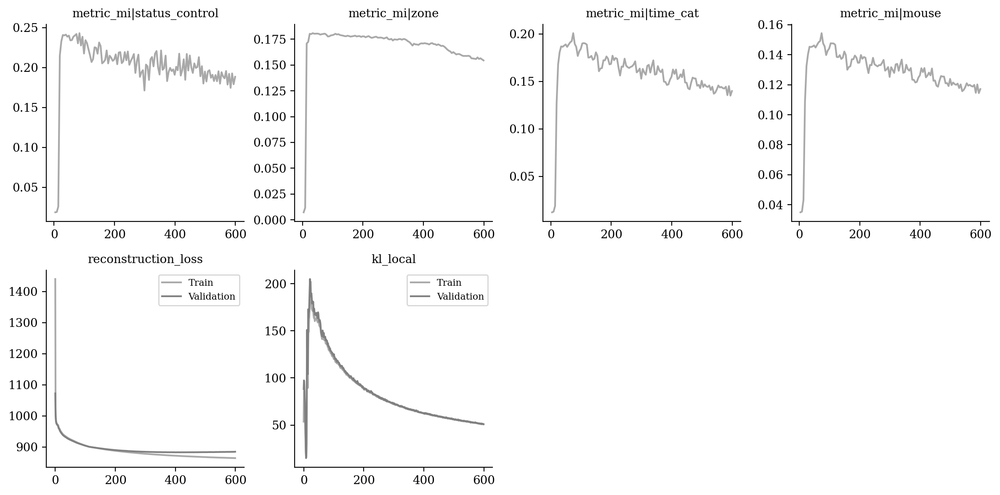

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

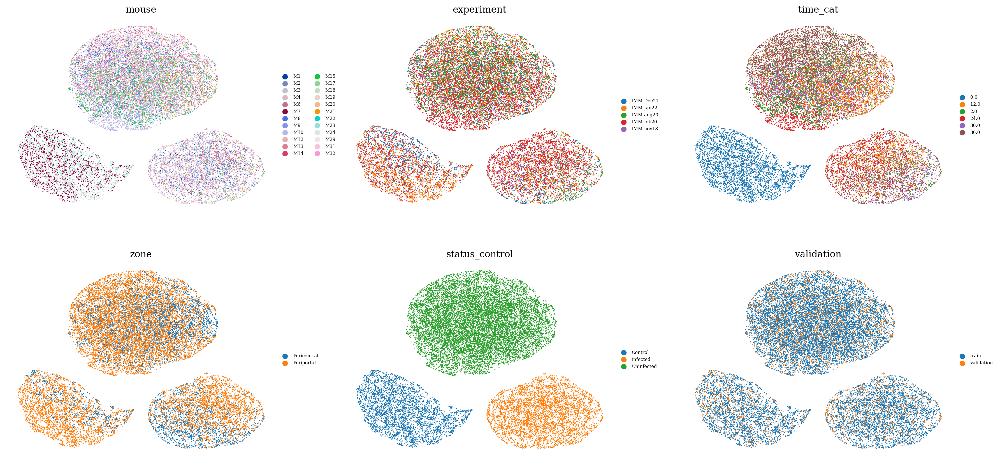

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

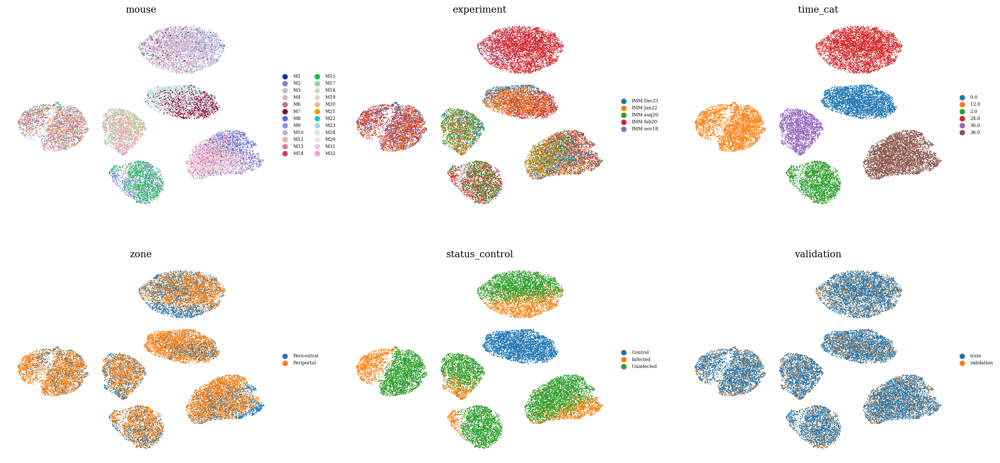

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

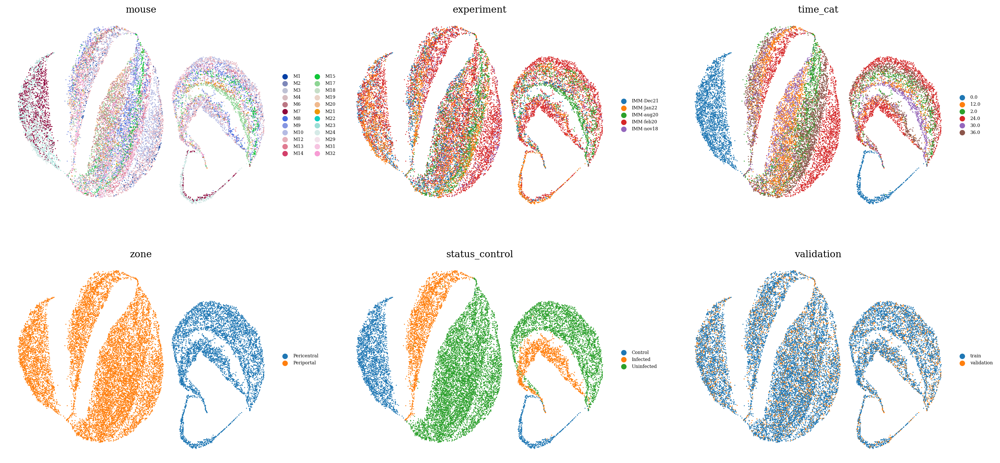

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

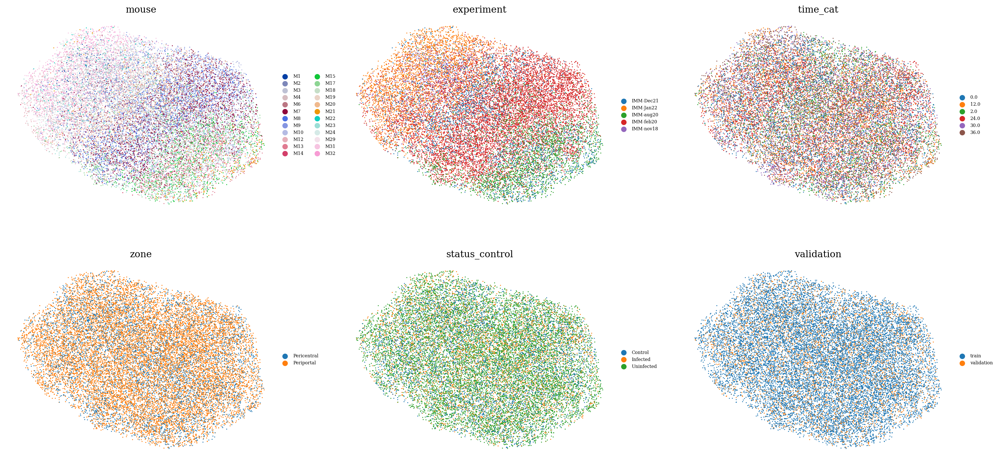

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

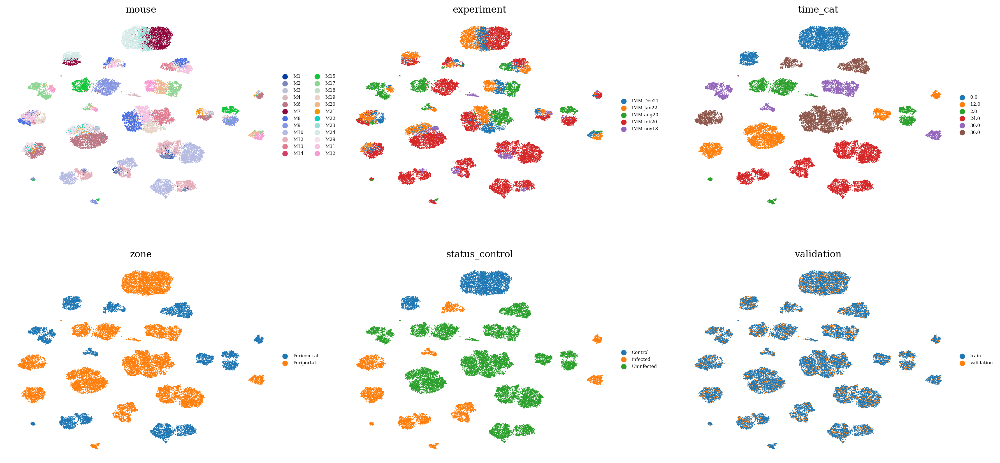

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
data = vae.get_latent_representation()

import sklearn
factors_indices = sorted([[indice, config.obs_key] for config in DM.configurations.items for indice in config.reserved_latent_indices])
factors = np.vstack([sklearn.preprocessing.LabelEncoder().fit_transform(
    adata.obs[j].copy().astype(str).values.flatten()
) for i, j in factors_indices]).T

data = data[:, [i for i, j in factors_indices]]

maxMIG = vae.get_MI_precalculated(data=data, factors=factors, variation="maxMIG", discretization_bins=256)
maxMIG_mean = np.mean(maxMIG)
maxMIG_mean

0.905439335588485

In [20]:
data = vae.get_latent_representation()

import sklearn
factors_indices = sorted([[indice, config.obs_key] for config in DM.configurations.items for indice in config.reserved_latent_indices])
factors = np.vstack([sklearn.preprocessing.LabelEncoder().fit_transform(
    adata.obs[j].copy().astype(str).values.flatten()
) for i, j in factors_indices]).T

data = data[:, [i for i, j in factors_indices]]

maxMIG = vae.get_MI_precalculated(data=data[vae.validation_indices, :], factors=factors[vae.validation_indices, :], variation="maxMIG", discretization_bins=256)
maxMIG_mean = np.mean(maxMIG)
maxMIG_mean

0.8536450516416391